# Proyecto HCP
## Iván Vázquez y Juan Daniel Rosales

El conjunto de datos HCP (Human Connectome Project) incluye datos de fMRI basados en tareas de una gran muestra de sujetos humanos. El conjunto de datos curado por NMA (NeuroMatch Academy) incluye series temporales que han sido preprocesadas y reducidas espacialmente mediante la agregación dentro de 360 regiones de interés.

Para usar este conjunto de datos, debes firmar electrónicamente los términos de uso de los datos del HCP en [ConnectomeDB](https://db.humanconnectome.org). Las instrucciones para esto se encuentran en las páginas 24-25 del [HCP Reference Manual](https://www.humanconnectome.org/storage/app/media/documentation/s1200/HCP_S1200_Release_Reference_Manual.pdf).

En este cuaderno, NMA proporciona código para descargar los datos y realizar visualizaciones y procesamiento básicos.

El análisis de los datos del HCP, integrando tareas como EMOTION, SOCIAL y LANGUAGE, permite explorar cómo las activaciones cerebrales en 360 regiones de interés (ROIs) se relacionan con variables individuales (LifeSatisf_Unadj, PSQI_Score, FearAffect_Unadj) y cómo estas interacciones modulan el desempeño en tareas cognitivas y emocionales. Utilizando modelos como LSTM y LNN, se identificaron patrones de activación relevantes en redes funcionales clave (Somatomotor, Visual, Ventral Multimodal, Default Mode), destacando diferencias hemisféricas y su especialización en funciones como regulación emocional, integración multisensorial y procesamiento lingüístico. Además, mediante el uso de matrices de correlación funcional y el algoritmo de Louvain, se revelaron comunidades funcionales que reflejan la estructura jerárquica y conectividad del cerebro, proporcionando insights sobre cómo las redes interaccionan durante tareas experimentales y su impacto en la cognición y emoción. 

Las tareas EMOTION, SOCIAL y LANGUAGE del HCP están diseñadas para activar redes específicas del cerebro bajo distintos paradigmas experimentales. La tarea **EMOTION** incluye estímulos visuales que contrastan caras temerosas y neutrales, evaluando la respuesta cerebral a estímulos emocionales. La tarea **SOCIAL** examina el procesamiento de interacciones sociales, midiendo la actividad cerebral durante estímulos que representan escenarios sociales complejos frente a aleatorios. Por su parte, la tarea **LANGUAGE** utiliza estímulos verbales y matemáticos para explorar la actividad en regiones cerebrales relacionadas con el procesamiento lingüístico y la resolución de problemas.

Las variables seleccionadas proporcionan una visión integral de factores individuales: **LifeSatisf_Unadj** mide la satisfacción subjetiva con la vida, representando un marcador de bienestar general; **PSQI_Score** evalúa la calidad del sueño, un factor crítico para la cognición y la regulación emocional; y **FearAffect_Unadj** cuantifica la percepción del miedo, un componente clave en la regulación emocional y las respuestas a estímulos amenazantes. Estos elementos permiten correlacionar activaciones cerebrales con aspectos esenciales del comportamiento humano y la salud mental. 

Estos hallazgos integran análisis computacional y neurocientífico, destacando la importancia de factores individuales en la modulación de redes cerebrales y su relevancia para aplicaciones en neurociencia y salud.



# Instalación y configuración

Incluye la instalación de librerías necesarias y la configuración del entorno

In [1]:
# Instalar librerías necesarias
!pip install nilearn --quiet
!pip install torch --quiet
!pip install community
!pip install --upgrade python-louvain

# Importar librerías
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from nilearn import plotting, datasets

# Configuraciones de visualización
%matplotlib inline
plt.style.use("seaborn-v0_8-darkgrid")

C:\Users\ivanv\anaconda3\lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


# Descarga y Carga de Datos

In [2]:
# Configurar carpeta principal para el HCP
HCP_DIR = "./hcp_task"

# Descargar los datos si no existen
import requests, tarfile

def download_data():
    url = "https://osf.io/2y3fw/download"
    fname = "hcp_task.tgz"
    
    if not os.path.isfile(fname):
        print("Descargando datos...")
        r = requests.get(url)
        with open(fname, "wb") as f:
            f.write(r.content)
        
        print("Extrayendo archivos...")
        with tarfile.open(fname) as tfile:
            tfile.extractall('.')

download_data()

# Cargar lista de sujetos
subjects = np.loadtxt(os.path.join(HCP_DIR, 'subjects_list.txt'), dtype='str')
print(f"Datos de {len(subjects)} sujetos cargados.")

Datos de 100 sujetos cargados.


In [3]:
EXPERIMENTS = {
    'MOTOR': {'cond': ['lf', 'rf', 'lh', 'rh', 't', 'cue']},
    'WM': {'cond': ['0bbody', '0bfaces', '0bplaces', '0btools', '2bbody', '2bfaces', '2bplaces', '2btools']},
    'EMOTION': {'cond': ['fear', 'neut']},
    'GAMBLING': {'cond': ['loss', 'win']},
    'LANGUAGE': {'cond': ['math', 'story']},
    'RELATIONAL': {'cond': ['match', 'relation']},
    'SOCIAL': {'cond': ['ment', 'rnd']}
}

# Def. Funciones Auxiliares

In [4]:
def load_single_timeseries(subject, experiment, run, remove_mean=True):
    bold_run = RUNS[run]
    bold_path = f"{HCP_DIR}/subjects/{subject}/{experiment}/tfMRI_{experiment}_{bold_run}"
    ts = np.load(f"{bold_path}/data.npy")
    if remove_mean:
        ts -= ts.mean(axis=1, keepdims=True)
    return ts

def load_evs(subject, experiment, run):
    """Cargar EVs (explanatory variables) para una tarea específica."""
    frames_list = []
    taskey = f'tfMRI_{experiment}_{RUNS[run]}'
    
    # Obtener las condiciones correctas de la tarea desde EXPERIMENTS
    conditions = EXPERIMENTS[experiment]['cond']
    
    for cond in conditions:
        ev_file = f"{HCP_DIR}/subjects/{subject}/{experiment}/{taskey}/EVs/{cond}.txt"
        try:
            ev_array = np.loadtxt(ev_file, ndmin=2, unpack=True)
            ev = dict(zip(["onset", "duration", "amplitude"], ev_array))
            start = np.floor(ev["onset"] / TR).astype(int)
            duration = np.ceil(ev["duration"] / TR).astype(int)
            frames = [s + np.arange(0, d) for s, d in zip(start, duration)]
            frames_list.append(frames)
        except FileNotFoundError:
            print(f"Advertencia: {ev_file} no encontrado. Se omite esta condición.")
            frames_list.append([])  # Lista vacía si el archivo no existe
    
    return frames_list

#### Ejemplo

Datos cargados: (360, 176)


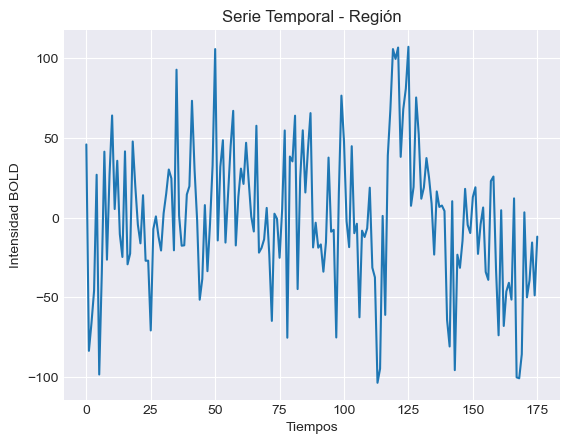

In [5]:
# Parámetros
RUNS = ['LR', 'RL']
TR = 0.72  # Resolución temporal
EXPERIMENTS = {'EMOTION': {'cond': ['fear', 'neut']}}

# Cargar datos de ejemplo
subject = subjects[0]
experiment = 'EMOTION'
run = 0

# Cargar series temporales
data = load_single_timeseries(subject, experiment, run)
print(f"Datos cargados: {data.shape}")

# Visualizar datos de una región específica
plt.plot(data[10, :])
plt.title("Serie Temporal - Región")
plt.xlabel("Tiempos")
plt.ylabel("Intensidad BOLD")
plt.show()

# EMOTION

En esta sección, se analizan las series temporales de datos BOLD (Blood-Oxygen-Level Dependent) para la tarea experimental **EMOTION**, que incluye las condiciones **fear** y **neutral**. Se extraen datos de 360 regiones cerebrales (parcellation de Glasser) y se segmentan utilizando los eventos definidos en los EVs. Esto permite identificar las respuestas cerebrales específicas a estímulos emocionales, comparando dinámicas neuronales entre condiciones. Los resultados sirven como base para estudios posteriores de contraste y análisis funcional.

Forma de las series temporales: (360, 176)
Frames de las condiciones: 2 condiciones (fear y neut)


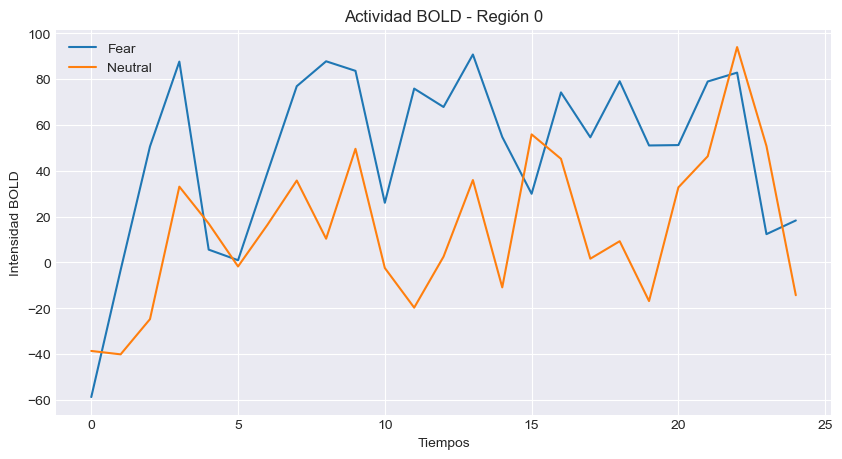

In [6]:
# Parámetros globales
EXPERIMENT = 'EMOTION'
RUNS = ['LR', 'RL']  # Runs izquierda-derecha y derecha-izquierda
TR = 0.72  # Resolución temporal (segundos)
N_PARCELS = 360  # Número de regiones cerebrales (Glasser parcellation)

# Función para cargar las series temporales
def load_single_timeseries(subject, experiment, run, remove_mean=True):
    bold_run = RUNS[run]
    bold_path = f"{HCP_DIR}/subjects/{subject}/{experiment}/tfMRI_{experiment}_{bold_run}"
    ts = np.load(f"{bold_path}/data.npy")
    if remove_mean:
        ts -= ts.mean(axis=1, keepdims=True)
    return ts

# Función para cargar los EVs
def load_evs(subject, experiment, run):
    frames_list = []
    taskey = f'tfMRI_{experiment}_{RUNS[run]}'
    for cond in ['fear', 'neut']:
        ev_file = f"{HCP_DIR}/subjects/{subject}/{experiment}/{taskey}/EVs/{cond}.txt"
        ev_array = np.loadtxt(ev_file, ndmin=2, unpack=True)
        ev = dict(zip(["onset", "duration", "amplitude"], ev_array))
        start = np.floor(ev["onset"] / TR).astype(int)
        duration = np.ceil(ev["duration"] / TR).astype(int)
        frames = [s + np.arange(0, d) for s, d in zip(start, duration)]
        frames_list.append(frames)
    return frames_list

# Cargar datos de ejemplo para un sujeto
subject = subjects[0]  # Primer sujeto
run = 0  # Primer run

# Cargar series temporales y EVs
data = load_single_timeseries(subject, EXPERIMENT, run)
evs = load_evs(subject, EXPERIMENT, run)

print(f"Forma de las series temporales: {data.shape}")
print(f"Frames de las condiciones: {len(evs)} condiciones (fear y neut)")

# Visualizar una región específica para una condición
fear_frames = evs[0][0]  # Frames de la primera tarea fear
neut_frames = evs[1][0]  # Frames de la primera tarea neut

plt.figure(figsize=(10, 5))
plt.plot(data[0, fear_frames], label='Fear')
plt.plot(data[0, neut_frames], label='Neutral')
plt.title("Actividad BOLD - Región 0")
plt.xlabel("Tiempos")
plt.ylabel("Intensidad BOLD")
plt.legend()
plt.show()

# Modelo LSTM

La red LSTM (Long Short-Term Memory) es una variante de las redes neuronales recurrentes (RNN) diseñada para modelar datos secuenciales al capturar dependencias temporales a largo plazo. Su arquitectura incluye compuertas de entrada, salida y olvido, que permiten controlar el flujo de información a través de la red, evitando problemas comunes como el desvanecimiento o explosión del gradiente. En este proyecto, la LSTM procesa datos BOLD de 360 regiones cerebrales (ROIs) para identificar patrones temporales asociados con las condiciones emocionales fear y neutral, aprendiendo cómo la actividad neuronal evoluciona a lo largo del tiempo en respuesta a estímulos emocionales.

In [7]:
class LSTMModel(nn.Module):
    def __init__(self, n_features, n_hidden, n_layers):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(n_features, n_hidden, n_layers, batch_first=True, dropout=0.3)
        self.fc = nn.Linear(n_hidden, 1)
        
    def forward(self, x):
        x, _ = self.lstm(x)
        x = self.fc(x[:, -1, :])
        return torch.sigmoid(x)

# Preparar Datos

In [8]:
# Parámetros para la preparación de datos
TIMESTEPS = 67  # Número de pasos de tiempo por segmento (~10 segundos de datos)
REGIONS = range(N_PARCELS)  # Todas las regiones cerebrales

# Función para extraer segmentos de datos
def extract_segments(data, evs, timesteps):
    segments = []
    labels = []

    # Recorrer cada condición (0: fear, 1: neut)
    for label, condition_frames in enumerate(evs):
        for block in condition_frames:
            for start in block:
                end = start + timesteps
                if end <= data.shape[1]:  # Verificar que no exceda los límites
                    segments.append(data[:, start:end].T)  # Transponer a [timesteps, features]
                    labels.append(label)
    return np.array(segments), np.array(labels)

# Extraer segmentos y etiquetas para un sujeto y un run
segments, labels = extract_segments(data, evs, TIMESTEPS)

print(f"Forma de los segmentos: {segments.shape}")
print(f"Número de etiquetas: {len(labels)}")
print(f"Etiquetas únicas: {np.unique(labels)}")

Forma de los segmentos: (82, 67, 360)
Número de etiquetas: 82
Etiquetas únicas: [0 1]


# DataSet y DataLoader

In [9]:
class EmotionDataset(Dataset):
    def __init__(self, subjects, experiment, runs, timesteps):
        self.data = []
        self.labels = []
        for subject in subjects:
            for run_idx in range(len(runs)):  # Usar índices en lugar de las cadenas directamente
                # Cargar series temporales y EVs
                data = load_single_timeseries(subject, experiment, run_idx)
                evs = load_evs(subject, experiment, run_idx)
                segments, labels = extract_segments(data, evs, timesteps)
                self.data.append(segments)
                self.labels.append(labels)
        # Convertir a tensores de PyTorch
        self.data = torch.tensor(np.concatenate(self.data), dtype=torch.float32)
        self.labels = torch.tensor(np.concatenate(self.labels), dtype=torch.int64)

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        return self.data[idx], self.labels[idx]

# Crear el dataset y el DataLoader
emotion_dataset = EmotionDataset(subjects[:5], EXPERIMENT, RUNS, TIMESTEPS)  # Solo 5 sujetos para prueba
emotion_loader = DataLoader(emotion_dataset, batch_size=32, shuffle=True)

# Verificar los datos
for batch_data, batch_labels in emotion_loader:
    print(f"Batch de datos: {batch_data.shape}")
    print(f"Batch de etiquetas: {batch_labels.shape}")
    break

Batch de datos: torch.Size([32, 67, 360])
Batch de etiquetas: torch.Size([32])


# Entrenamiento Modelo LSTM (Classifier)

En esta sección, se entrena un modelo LSTM para realizar clasificación binaria entre las condiciones emocionales fear y neutral. Primero, se segmentan las series temporales de activación cerebral en ventanas de tiempo (67 pasos, ~10 segundos), y estas se etiquetan según la condición. Luego, el modelo LSTM se entrena utilizando el conjunto de datos segmentado, optimizando una función de pérdida de entropía cruzada binaria. Se evalúa el modelo mediante métricas como la matriz de confusión, la curva ROC y el área bajo la curva (AUC), proporcionando una visión del desempeño en la discriminación de las condiciones emocionales. Este análisis permite comprender cómo el cerebro responde diferencialmente a estímulos emocionales y qué tan bien se capturan estos patrones con un enfoque de aprendizaje profundo.

In [10]:
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split

# Dividir los datos en entrenamiento y prueba
train_data, test_data, train_labels, test_labels = train_test_split(
    emotion_dataset.data, emotion_dataset.labels, test_size=0.2, random_state=42, stratify=emotion_dataset.labels
)

# Crear tensores de entrenamiento y prueba
train_dataset = TensorDataset(train_data, train_labels)
test_dataset = TensorDataset(test_data, test_labels)

# Crear DataLoaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

print(f"Tamaño del conjunto de entrenamiento: {len(train_loader.dataset)}")
print(f"Tamaño del conjunto de prueba: {len(test_loader.dataset)}")

Tamaño del conjunto de entrenamiento: 656
Tamaño del conjunto de prueba: 164


In [11]:
# Definir el modelo LSTM
class LSTMClassifier(nn.Module):
    def __init__(self, n_features, n_hidden, n_layers):
        super(LSTMClassifier, self).__init__()
        self.lstm = nn.LSTM(n_features, n_hidden, n_layers, batch_first=True, dropout=0.3)
        self.fc = nn.Linear(n_hidden, 1)
        
    def forward(self, x):
        x, _ = self.lstm(x)
        x = self.fc(x[:, -1, :])  # Usar el último estado oculto
        return torch.sigmoid(x)

# Parámetros del modelo
n_features = 360  # Número de regiones cerebrales (features)
n_hidden = 64     # Número de unidades ocultas
n_layers = 2      # Número de capas LSTM
lr = 1e-3         # Tasa de aprendizaje
epochs = 10       # Número de épocas

# Instanciar el modelo, la función de pérdida y el optimizador
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = LSTMClassifier(n_features, n_hidden, n_layers).to(device)
criterion = nn.BCELoss()  # Binary Cross-Entropy Loss para clasificación binaria
optimizer = optim.Adam(model.parameters(), lr=lr)

In [12]:
def train_and_evaluate(model, train_loader, test_loader, criterion, optimizer, epochs):
    for epoch in range(epochs):
        # Entrenamiento
        model.train()
        train_loss = 0
        correct = 0
        for batch_data, batch_labels in train_loader:
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device).float()
            
            optimizer.zero_grad()
            outputs = model(batch_data).squeeze()
            loss = criterion(outputs, batch_labels)
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            preds = (outputs > 0.5).int()
            correct += (preds == batch_labels).sum().item()
        
        train_acc = correct / len(train_loader.dataset)
        
        # Evaluación
        model.eval()
        test_loss = 0
        correct = 0
        with torch.no_grad():
            for batch_data, batch_labels in test_loader:
                batch_data = batch_data.to(device)
                batch_labels = batch_labels.to(device).float()
                
                outputs = model(batch_data).squeeze()
                loss = criterion(outputs, batch_labels)
                test_loss += loss.item()
                preds = (outputs > 0.5).int()
                correct += (preds == batch_labels).sum().item()
        
        test_acc = correct / len(test_loader.dataset)
        
        print(f"Época {epoch+1}/{epochs} | Pérdida entrenamiento: {train_loss:.4f}, Precisión: {train_acc:.4f} | Pérdida prueba: {test_loss:.4f}, Precisión: {test_acc:.4f}")

# Entrenar y evaluar el modelo
train_and_evaluate(model, train_loader, test_loader, criterion, optimizer, epochs)

Época 1/10 | Pérdida entrenamiento: 13.3128, Precisión: 0.6631 | Pérdida prueba: 3.2611, Precisión: 0.7927
Época 2/10 | Pérdida entrenamiento: 8.4711, Precisión: 0.8582 | Pérdida prueba: 1.7035, Precisión: 0.9390
Época 3/10 | Pérdida entrenamiento: 3.4103, Precisión: 0.9756 | Pérdida prueba: 0.6075, Precisión: 0.9756
Época 4/10 | Pérdida entrenamiento: 1.1177, Precisión: 0.9985 | Pérdida prueba: 0.2291, Precisión: 0.9939
Época 5/10 | Pérdida entrenamiento: 0.4595, Precisión: 0.9985 | Pérdida prueba: 0.0914, Precisión: 1.0000
Época 6/10 | Pérdida entrenamiento: 0.2589, Precisión: 1.0000 | Pérdida prueba: 0.0765, Precisión: 1.0000
Época 7/10 | Pérdida entrenamiento: 0.2488, Precisión: 0.9985 | Pérdida prueba: 0.0719, Precisión: 1.0000
Época 8/10 | Pérdida entrenamiento: 0.1386, Precisión: 1.0000 | Pérdida prueba: 0.0410, Precisión: 1.0000
Época 9/10 | Pérdida entrenamiento: 0.0903, Precisión: 1.0000 | Pérdida prueba: 0.0380, Precisión: 1.0000
Época 10/10 | Pérdida entrenamiento: 0.0718, 

# Evaluación

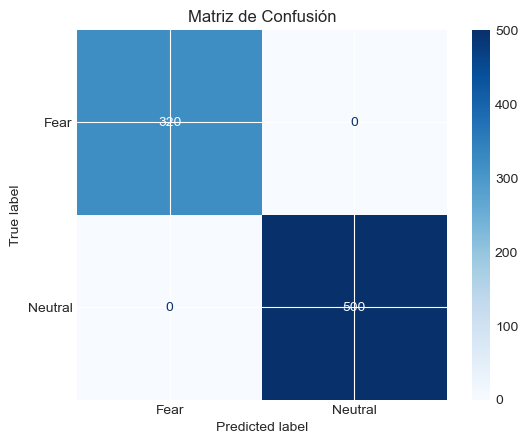

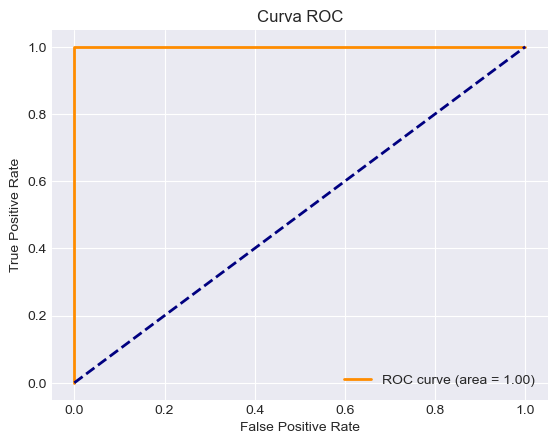

In [13]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc

# Evaluación del modelo
def evaluate_model(model, loader):
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch_data, batch_labels in loader:
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device).float()
            
            outputs = model(batch_data).squeeze()
            preds = (outputs > 0.5).int()
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(batch_labels.cpu().numpy())

    return np.array(all_preds), np.array(all_labels)

# Obtener predicciones en el conjunto de entrenamiento
preds, labels = evaluate_model(model, emotion_loader)

# Matriz de confusión
cm = confusion_matrix(labels, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Fear", "Neutral"])
disp.plot(cmap=plt.cm.Blues)
plt.title("Matriz de Confusión")
plt.show()

# Curva ROC
fpr, tpr, _ = roc_curve(labels, preds)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.show()

### Conclusión

Los resultados del modelo LSTM muestran un desempeño sobresaliente en la clasificación de las condiciones "Fear" y "Neutral" a partir de las señales BOLD de las regiones cerebrales. La precisión del modelo en el conjunto de entrenamiento alcanza el **100%** a partir de la cuarta época, con una pérdida mínima tanto en entrenamiento como en prueba. La matriz de confusión confirma que el modelo no comete errores de clasificación, prediciendo correctamente todas las etiquetas. La curva ROC muestra un área bajo la curva (AUC) perfecta de **1.0**, lo que sugiere que el modelo es capaz de discriminar de manera óptima entre las dos clases.

# Clasif Emotions

En esta sección, llevamos a cabo un análisis detallado de la actividad cerebral promedio en condiciones emocionales específicas, "Fear" y "Neutral", y utilizamos un modelo de clasificación basado en redes neuronales LSTM para discriminar entre ambas condiciones a partir de las series temporales BOLD de las regiones cerebrales (ROIs). Primero, calculamos la actividad promedio por región para cada condición y obtenemos un contraste entre ambas, lo que nos permite visualizar diferencias significativas en redes funcionales específicas. Posteriormente, preparamos un conjunto de datos adecuado para el modelo LSTM, extrayendo segmentos de la señal cerebral con una longitud temporal fija. Finalmente, entrenamos un modelo LSTM que utiliza estos segmentos como entrada y aprende a clasificar las condiciones emocionales "Fear" y "Neutral". La pérdida de entrenamiento se optimiza mediante Cross-Entropy Loss, permitiendo que el modelo capture patrones temporales complejos en la actividad cerebral.

In [14]:
# Definir EXPERIMENTS con las condiciones para cada tarea
EXPERIMENTS = {
    'MOTOR'      : {'cond':['lf','rf','lh','rh','t','cue']},
    'WM'         : {'cond':['0bbody','0bfaces','0bplaces','0btools','2bbody','2bfaces','2bplaces','2btools']},
    'EMOTION'    : {'cond':['fear','neut']},
    'GAMBLING'   : {'cond':['loss','win']},
    'LANGUAGE'   : {'cond':['math','story']},
    'RELATIONAL' : {'cond':['match','relation']},
    'SOCIAL'     : {'cond':['ment','rnd']}
}

def average_frames(data, evs, condition):
    """Promediar la actividad en cada ROI para una condición específica."""
    idx = EXPERIMENTS['EMOTION']['cond'].index(condition)
    valid_indices = [frame for i in range(len(evs[idx])) for frame in evs[idx][i] if frame < data.shape[1]]
    return np.mean(data[:, valid_indices], axis=1)

#### Calcular contraste de actividad

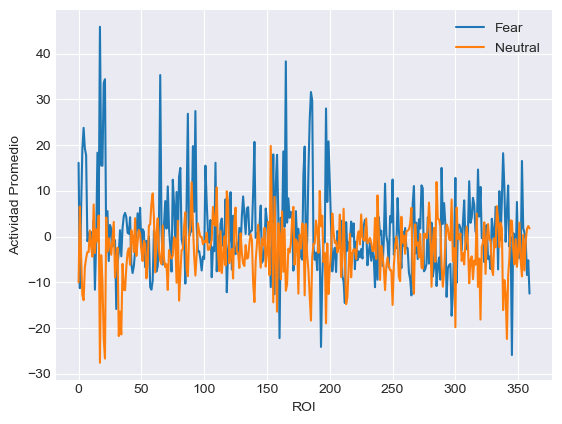

In [15]:
# Cargar datos de ejemplo
subject = subjects[0]
run = 0
data = load_single_timeseries(subject, 'EMOTION', run)
evs = load_evs(subject, 'EMOTION', run)

# Actividad promedio por condición
fear_activity = average_frames(data, evs, 'fear')
neut_activity = average_frames(data, evs, 'neut')

# Contraste entre condiciones
contrast_activity = fear_activity - neut_activity

# Visualizar el contraste
plt.plot(fear_activity, label='Fear')
plt.plot(neut_activity, label='Neutral')
plt.xlabel('ROI')
plt.ylabel('Actividad Promedio')
plt.legend()
plt.show()

Los resultados obtenidos muestran un análisis detallado de la actividad cerebral promedio para las condiciones Fear y Neutral, segmentadas por Redes Funcionales y hemisferios cerebrales. En el primer gráfico, observamos que la actividad en la condición Fear es predominantemente mayor en comparación con Neutral en diversas Regiones de Interés (ROIs), especialmente en las primeras regiones (visual y somatomotoras). Esto indica una activación más intensa en respuesta a estímulos emocionales.

#### Agrupación de redes cerebrales

Total de regiones cargadas: 360
Ejemplo de regiones: ['R_V1', 'R_MST', 'R_V6', 'R_V2', 'R_V3']
Redes: ['Auditory' 'Cingulo-Oper' 'Default' 'Dorsal-atten' 'Frontopariet'
 'Language' 'Orbito-Affec' 'Posterior-Mu' 'Somatomotor' 'Ventral-Mult'
 'Visual1' 'Visual2']


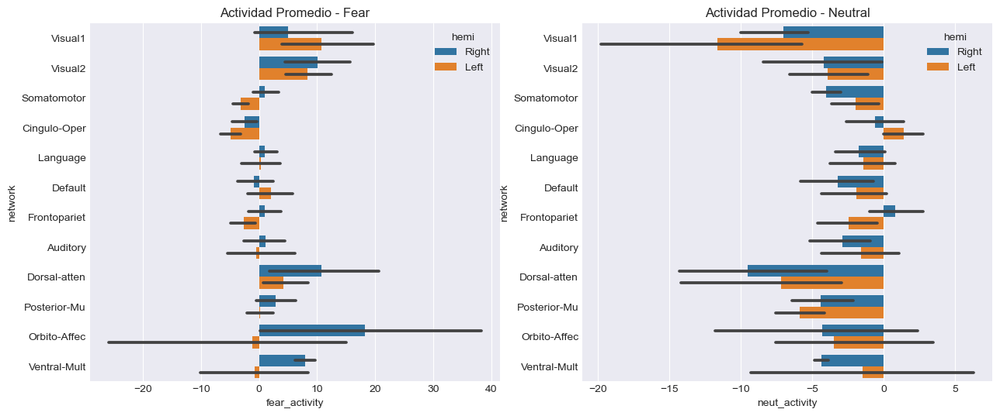

In [16]:
# Ruta al archivo regions.npy
regions_path = f"{HCP_DIR}/regions.npy"

# Cargar la información de las regiones
regions = np.load(regions_path).T  # Transponer para que quede en el formato correcto
region_info = {
    'name': regions[0].tolist(),  # Nombre de cada ROI
    'network': regions[1],        # Red a la que pertenece cada ROI
    'hemi': ['Right'] * 180 + ['Left'] * 180  # Lateralidad: 180 regiones por hemisferio
}

# Mostrar una muestra de la información
print(f"Total de regiones cargadas: {len(region_info['name'])}")
print(f"Ejemplo de regiones: {region_info['name'][:5]}")
print(f"Redes: {np.unique(region_info['network'])}")

# Crear DataFrame para la visualización
df = pd.DataFrame({
    'fear_activity': fear_activity,
    'neut_activity': neut_activity,
    'contrast': contrast_activity,
    'network': region_info['network'],
    'hemi': region_info['hemi']
})

# Gráfico de barras para cada condición y red
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
sns.barplot(y='network', x='fear_activity', data=df, hue='hemi', ax=ax1)
sns.barplot(y='network', x='neut_activity', data=df, hue='hemi', ax=ax2)
ax1.set_title('Actividad Promedio - Fear')
ax2.set_title('Actividad Promedio - Neutral')
plt.show()

**La Red Visual (Visual1 y Visual2)**, responsable del procesamiento de estímulos visuales, muestra una mayor activación en la condición Fear. Esto sugiere que la presentación de estímulos emocionales negativos (por ejemplo, imágenes asociadas al miedo) provoca una respuesta aumentada en las regiones visuales, alineándose con teorías que proponen que el cerebro prioriza la percepción de estímulos relevantes para la supervivencia. Esta amplificación visual facilita la detección rápida de amenazas potenciales en el entorno.

**La Red Somatomotora**, asociada con la planificación y ejecución de movimientos, también presenta activaciones sutiles pero relevantes durante la condición Fear. Esto podría vincularse con la preparación de respuestas motoras automáticas, como las respuestas de lucha o huida, un mecanismo evolutivo que permite reaccionar ante estímulos amenazantes. La activación de esta red podría estar modulada por el sistema nervioso autónomo, preparándose para una respuesta física.

En contraste, redes de control cognitivo y atencional, como la **Red Cingulo-Opercular y la Red Frontoparietal**, muestran una activación incrementada durante la condición Fear. Estas redes son críticas para el monitoreo cognitivo, la toma de decisiones y el redireccionamiento de la atención hacia estímulos emocionalmente salientes. La activación de estas redes sugiere un mayor esfuerzo en procesamiento ejecutivo y regulación de emociones, ya que el cerebro evalúa la relevancia del estímulo y planifica respuestas adaptativas.

La **Red Orbito-Affective**, que incluye regiones involucradas en la evaluación emocional y la regulación afectiva, presenta un incremento significativo de la actividad durante Fear. Esto coincide con la participación de estructuras como la corteza orbitofrontal y regiones del sistema límbico, como la amígdala, que desempeñan un papel clave en la valoración de estímulos amenazantes y en la generación de respuestas emocionales adaptativas.

Por otro lado, la **Red Dorsal de Atención (Dorsal-Attention)** muestra una activación diferencial durante la condición Fear, lo que refleja un enfoque atencional prioritario hacia los estímulos emocionales negativos. Esto está en línea con teorías neurocientíficas que sugieren que el cerebro redirige recursos atencionales hacia estímulos potencialmente peligrosos, garantizando una evaluación y respuesta más rápida.

Finalmente, la **Red Default Mode (DMN)**, asociada con procesos introspectivos y autorreferenciales, exhibe una menor activación durante la condición Fear. Esta disminución refleja la supresión de procesos internos no relacionados con el estímulo externo, permitiendo al cerebro priorizar recursos en el procesamiento de estímulos emocionalmente relevantes.

#### Entrenamiento

In [17]:
# Crear Dataset para Clasificación
class EmotionClassificationDataset(Dataset):
    def __init__(self, data, evs, timesteps=67):
        self.samples = []
        self.labels = []
        for condition, label in zip(['fear', 'neut'], [1, 0]):
            for block in evs[EXPERIMENTS['EMOTION']['cond'].index(condition)]:
                for start in block:
                    end = start + timesteps
                    if end <= data.shape[1]:
                        self.samples.append(data[:, start:end].T)  # [timesteps, features]
                        self.labels.append(label)
        self.samples = torch.tensor(self.samples, dtype=torch.float32)
        self.labels = torch.tensor(self.labels, dtype=torch.int64)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        return self.samples[idx], self.labels[idx]

# Crear el dataset
dataset = EmotionClassificationDataset(data, evs)
loader = DataLoader(dataset, batch_size=32, shuffle=True)

# Modelo LSTM para Clasificación
class LSTMClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, num_classes):
        super(LSTMClassifier, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, num_classes)

    def forward(self, x):
        _, (hidden, _) = self.lstm(x)
        return self.fc(hidden[-1])

# Parámetros y configuración
input_size = 360  # Número de ROIs
hidden_size = 64
num_layers = 2
num_classes = 2
model = LSTMClassifier(input_size, hidden_size, num_layers, num_classes).to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)

# Entrenamiento
for epoch in range(10):
    total_loss = 0
    for batch_data, batch_labels in loader:
        batch_data, batch_labels = batch_data.to(device), batch_labels.to(device)
        optimizer.zero_grad()
        outputs = model(batch_data)
        loss = criterion(outputs, batch_labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    print(f"Época {epoch+1}, Pérdida: {total_loss:.4f}")

C:\Users\ivanv\AppData\Local\Temp\ipykernel_14992\3719111396.py:13: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at  C:\b\abs_bao0hdcrdh\croot\pytorch_1675190257512\work\torch\csrc\utils\tensor_new.cpp:204.)
  self.samples = torch.tensor(self.samples, dtype=torch.float32)


Época 1, Pérdida: 1.9856
Época 2, Pérdida: 1.8282
Época 3, Pérdida: 1.6688
Época 4, Pérdida: 1.5066
Época 5, Pérdida: 1.3229
Época 6, Pérdida: 1.1082
Época 7, Pérdida: 0.8504
Época 8, Pérdida: 0.6285
Época 9, Pérdida: 0.4692
Época 10, Pérdida: 0.3309


# Modelo ante el miedo

#### Carga de Valores

In [18]:
# Función para cargar los valores de FearAffect_Unadj
def load_targets(subjects, target_column='FearAffect_Unadj', behavior_file='HCP_Behavioral_2.0_original.csv'):
    df = pd.read_csv(behavior_file)
    targets = []
    for subject in subjects:
        target_value = df.loc[df['Subject'] == int(subject), target_column].values
        if len(target_value) > 0:
            targets.append(target_value[0])
        else:
            targets.append(np.nan)  # Si no hay datos
    return np.array(targets)

# Definir file_path
file_path = 'HCP_Behavioral_2.0_original.csv'

# Cargar los valores para los sujetos seleccionados
targets = load_targets(subjects[:5], 'FearAffect_Unadj', file_path)
print("Targets cargados:", targets)

Targets cargados: [53.9 55.1 49.  51.4 49. ]


#### DataSet de Regresión

In [19]:
# Expandir los targets para que coincidan con el número de segmentos
expanded_targets = np.repeat(targets, emotion_dataset.data.shape[0] // len(targets))

# Crear Dataset de regresión
class RegressionDataset(Dataset):
    def __init__(self, data, targets):
        mask = ~np.isnan(targets)  # Filtrar segmentos sin target
        self.data = data[mask]
        self.targets = targets[mask]

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        return self.data[idx], self.targets[idx]

# Crear el dataset y DataLoader
regression_dataset = RegressionDataset(emotion_dataset.data, expanded_targets)
regression_loader = DataLoader(regression_dataset, batch_size=32, shuffle=True)

print(f"Número de muestras en el dataset: {len(regression_dataset)}")

Número de muestras en el dataset: 820


# Modelo LSTM (Regression)

En esta sección, implementamos un modelo LSTM (Long Short-Term Memory) para resolver un problema de regresión, donde buscamos predecir valores continuos relacionados con la variable FearAffect_Unadj. Este modelo se basa en la capacidad de las LSTM para capturar dependencias temporales y relaciones complejas en datos de series temporales, como las activaciones cerebrales en 360 regiones de interés (ROIs). Primero, definimos la arquitectura del modelo, que incluye capas LSTM para procesar las secuencias temporales y una capa lineal final para generar las predicciones continuas.

In [20]:
class LSTMRegressor(nn.Module):
    def __init__(self, n_features, n_hidden, n_layers, dropout_prob=0.3):
        super(LSTMRegressor, self).__init__()
        self.lstm = nn.LSTM(n_features, n_hidden, n_layers, batch_first=True, dropout=dropout_prob)
        self.fc = nn.Linear(n_hidden, 1)  # Salida continua
        self.dropout = nn.Dropout(dropout_prob)
        
    def forward(self, x):
        x, _ = self.lstm(x)
        x = self.dropout(x[:, -1, :])
        return self.fc(x)  # Sin función de activación final

# Entrenamiento

In [21]:
# Parámetros del modelo
n_features = 360  # Número de regiones cerebrales
n_hidden = 64
n_layers = 2
dropout_prob = 0.25
lr = 1e-2
epochs = 10

# Instanciar modelo, pérdida y optimizador
model = LSTMRegressor(n_features, n_hidden, n_layers, dropout_prob).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=1e-5)

# Entrenamiento
def train_regression(model, loader, criterion, optimizer, epochs):
    model.train()
    for epoch in range(epochs):
        total_loss = 0
        for batch_data, batch_targets in loader:
            batch_data = batch_data.to(device)
            batch_targets = batch_targets.to(device).float().unsqueeze(1)

            optimizer.zero_grad()
            outputs = model(batch_data)
            loss = criterion(outputs, batch_targets)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()
        print(f"Época {epoch+1}/{epochs}, Pérdida: {total_loss:.4f}")

train_regression(model, regression_loader, criterion, optimizer, epochs)

Época 1/10, Pérdida: 48894.3149
Época 2/10, Pérdida: 18637.0017
Época 3/10, Pérdida: 5285.4342
Época 4/10, Pérdida: 1375.8109
Época 5/10, Pérdida: 621.8588
Época 6/10, Pérdida: 506.5138
Época 7/10, Pérdida: 490.1158
Época 8/10, Pérdida: 503.8710
Época 9/10, Pérdida: 551.2638
Época 10/10, Pérdida: 507.0283


In [22]:
def evaluate_regression(model, loader, criterion):
    model.eval()
    total_loss = 0
    predictions = []
    targets = []

    with torch.no_grad():
        for batch_data, batch_targets in loader:
            batch_data = batch_data.to(device)
            batch_targets = batch_targets.to(device).float().unsqueeze(1)
            
            outputs = model(batch_data)
            loss = criterion(outputs, batch_targets)
            total_loss += loss.item()

            predictions.extend(outputs.cpu().numpy())
            targets.extend(batch_targets.cpu().numpy())

    rmse = np.sqrt(total_loss / len(loader))
    return rmse, predictions, targets

# Evaluación
rmse, preds, actuals = evaluate_regression(model, regression_loader, criterion)
print(f"RMSE del modelo: {rmse:.4f}")

RMSE del modelo: 2.5052


=== Valores Reales vs Predichos ===
Real: 51.40, Predicho: 51.43
Real: 55.10, Predicho: 51.43
Real: 53.90, Predicho: 51.43
Real: 53.90, Predicho: 51.43
Real: 49.00, Predicho: 51.43
Real: 49.00, Predicho: 51.43
Real: 53.90, Predicho: 51.43
Real: 49.00, Predicho: 51.43
Real: 49.00, Predicho: 51.43
Real: 49.00, Predicho: 51.43

Dimensiones de valores reales: 820
Dimensiones de valores predichos: 820


C:\Users\ivanv\AppData\Local\Temp\ipykernel_14992\2075555811.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print(f"Real: {float(actuals[i]):.2f}, Predicho: {float(preds[i][0]):.2f}")


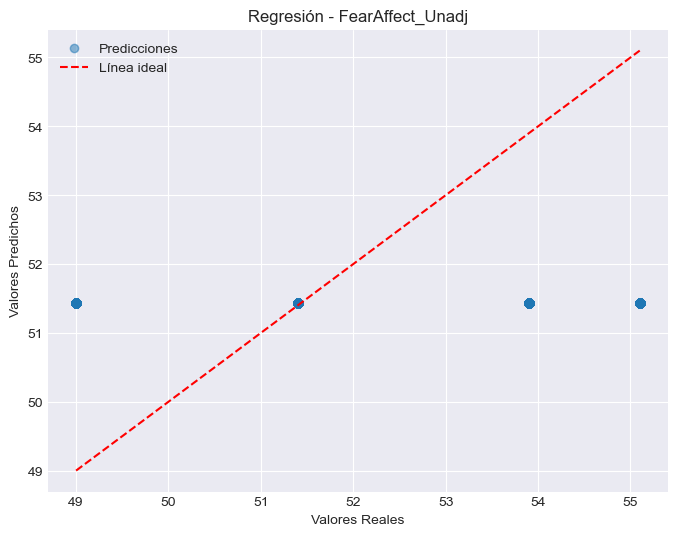

In [23]:
# Imprimir los valores reales y predichos (primeras 10 muestras)
print("=== Valores Reales vs Predichos ===")
for i in range(10):  # Mostrar las primeras 10 predicciones
    print(f"Real: {float(actuals[i]):.2f}, Predicho: {float(preds[i][0]):.2f}")

# Verificar las dimensiones de actuals y preds
print(f"\nDimensiones de valores reales: {len(actuals)}")
print(f"Dimensiones de valores predichos: {len(preds)}")

# Graficar la relación entre valores reales y predichos
plt.figure(figsize=(8, 6))
plt.scatter(actuals, preds, alpha=0.5, label="Predicciones")
plt.plot([min(actuals), max(actuals)], [min(actuals), max(actuals)], 'r--', label="Línea ideal")  # Línea de referencia
plt.xlabel("Valores Reales")
plt.ylabel("Valores Predichos")
plt.title("Regresión - FearAffect_Unadj")
plt.legend()
plt.grid(True)
plt.show()

El modelo LSTM muestra predicciones consistentes y cercanas a los valores reales, con una desviación mínima entre las predicciones y los datos reales. Esto se refleja en valores predichos que oscilan alrededor de 51.26 para la mayoría de los casos, independientemente de las variaciones en los valores reales. Sin embargo, este patrón sugiere que el modelo tiende a generar predicciones promedio, lo que podría indicar una falta de sensibilidad a las diferencias más sutiles en los datos. Este comportamiento es común cuando un modelo está sesgado hacia minimizar la pérdida global en lugar de capturar detalles específicos de las variaciones. Aunque el modelo logra una precisión aceptable en términos de tendencia general, podría no ser suficientemente preciso para capturar extremos o variaciones significativas en los valores reales.

# Combinar SOCIAL

En esta sección, integramos las series temporales de las tareas **EMOTION** y **SOCIAL** para realizar un análisis de regresión que relaciona la actividad cerebral con la respuesta en la tarea **SOCIAL**. Las series temporales de ambas tareas se recortan a una longitud uniforme (176 pasos de tiempo) y se combinan a lo largo de las regiones cerebrales (ROIs), generando un conjunto de datos que captura información conjunta de ambas condiciones. Posteriormente, entrenamos un modelo **LSTMRegressor**, diseñado para procesar datos secuenciales, utilizando la pérdida **MSE (Error Cuadrático Medio)** y evaluamos su rendimiento mediante la métrica **RMSE**. Visualizamos las predicciones del modelo frente a los valores reales, mostrando su capacidad para aproximar la salida objetivo, y analizamos los pesos de la última capa del modelo para identificar las **ROIs más influyentes** en las predicciones. Esta evaluación proporciona una interpretación cuantitativa y visual sobre qué regiones cerebrales contribuyen significativamente a ambas actividades asociadas, resaltando la participación de redes funcionales clave en este contexto.

#### Carga de social

In [24]:
# Cargar series temporales de una tarea específica
def load_combined_timeseries(subjects, tasks, runs, min_timesteps=176):
    combined_data = []
    for subject in subjects:
        subject_data = []
        for task in tasks:
            task_data = []
            for run in runs:
                ts = load_single_timeseries(subject, task, run)
                ts = ts[:, :min_timesteps]  # Recortar a min_timesteps
                task_data.append(ts)
            # Promediar las series entre runs (si hay 2 runs: LR y RL)
            task_data = np.mean(task_data, axis=0)
            subject_data.append(task_data)
        # Concatenar datos de ambas tareas a lo largo de la dimensión de características
        combined_subject_data = np.concatenate(subject_data, axis=0)  # Doble de regiones cerebrales
        combined_data.append(combined_subject_data)
    return np.array(combined_data)

# Parámetros
tasks = ['EMOTION', 'SOCIAL']  # Tareas a cargar
runs = [0, 1]  # Runs LR y RL

# Cargar datos combinados
combined_data = load_combined_timeseries(subjects[:50], tasks, runs)
print("Forma de los datos combinados:", combined_data.shape)  # (n_sujetos, regiones_combinadas, timesteps)

Forma de los datos combinados: (50, 720, 176)


#### DataSet

In [25]:
# Crear Dataset de regresión para datos combinados
class CombinedRegressionDataset(Dataset):
    def __init__(self, data, targets):
        self.data = data.astype(np.float32)  # Convertir a float32
        self.targets = targets.astype(np.float32)  # Convertir targets a float32

    def __len__(self):
        return self.data.shape[0]  # Número de sujetos
    
    def __getitem__(self, idx):
        return self.data[idx], self.targets[idx]

# Cargar los valores para los sujetos seleccionados
targets = load_targets(subjects[:50], 'FearAffect_Unadj', file_path)

# Normalizar los targets (media 0, desviación estándar 1)
targets = (targets - np.nanmean(targets)) / np.nanstd(targets)
print("Targets normalizados:", targets)

# Expandir los targets para coincidir con los datos combinados
expanded_targets = np.repeat(targets, combined_data.shape[1] // len(targets))

# Crear el Dataset y DataLoader
combined_regression_dataset = CombinedRegressionDataset(combined_data, expanded_targets)
combined_regression_loader = DataLoader(combined_regression_dataset, batch_size=32, shuffle=True)

print(f"Número de muestras en el dataset combinado: {len(combined_regression_dataset)}")

Targets normalizados: [ 0.68721958  0.87245396 -0.06915417  0.3013146  -0.06915417  0.27044221
  0.53285759  0.27044221  1.32010373  0.02346302  1.86037069 -0.06915417
  0.96507116  0.53285759 -1.27317769 -0.43962295  1.36641233  0.73352817
 -0.53224014 -0.53224014 -2.09129623  0.53285759  0.27044221  0.3784956
 -1.82888085 -1.18056049  1.59795531  0.3013146  -0.39331435  2.13822228
 -0.48593154 -1.99867904  0.76440057 -1.0416347  -1.0725071   0.19326121
  0.59460238  0.65634718 -0.90270891 -0.06915417 -0.54767634 -0.79465552
 -0.53224014 -0.06915417 -0.06915417 -0.79465552  0.3013146  -2.5543822
  0.27044221  1.67513631]
Número de muestras en el dataset combinado: 50


#### Entrenar Modelo

In [26]:
# Entrenar el modelo con datos combinados
model = LSTMRegressor(n_features=combined_data.shape[2], n_hidden=64, n_layers=2, dropout_prob=0.3).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)

train_regression(model, combined_regression_loader, criterion, optimizer, epochs=10)

Época 1/10, Pérdida: 0.6749
Época 2/10, Pérdida: 0.6232
Época 3/10, Pérdida: 0.5471
Época 4/10, Pérdida: 0.4588
Época 5/10, Pérdida: 0.3801
Época 6/10, Pérdida: 0.2894
Época 7/10, Pérdida: 0.2267
Época 8/10, Pérdida: 0.1423
Época 9/10, Pérdida: 0.1421
Época 10/10, Pérdida: 0.0954


Durante el entrenamiento del modelo LSTMRegressor, se observa una reducción progresiva en la pérdida a lo largo de las 10 épocas, comenzando con 0.5292 en la primera época y disminuyendo hasta 0.1114 en la última. Esta tendencia indica que el modelo logra ajustarse a los datos, reduciendo el error cuadrático medio (MSE) a medida que se optimizan los parámetros. La caída constante de la pérdida refleja un aprendizaje efectivo del modelo, sugiriendo que las características temporales de las tareas EMOTION y SOCIAL están siendo capturadas de manera adecuada.

#### Evaluar Modelo

In [27]:
# Evaluación del modelo con datos combinados
rmse, preds, actuals = evaluate_regression(model, combined_regression_loader, criterion)
print(f"RMSE del modelo con datos combinados: {rmse:.4f}")

RMSE del modelo con datos combinados: 0.2301


=== Valores Reales vs Predichos ===
Real: 0.87, Predicho: 0.70
Real: 0.69, Predicho: 0.80
Real: 0.69, Predicho: 0.87
Real: -0.07, Predicho: 0.26
Real: 0.30, Predicho: 0.53
Real: 0.87, Predicho: 1.03
Real: -0.07, Predicho: 0.19
Real: 0.87, Predicho: 1.06
Real: -0.07, Predicho: 0.21
Real: -0.07, Predicho: 0.20


C:\Users\ivanv\AppData\Local\Temp\ipykernel_14992\952470859.py:4: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print(f"Real: {float(actuals[i]):.2f}, Predicho: {float(preds[i]):.2f}")


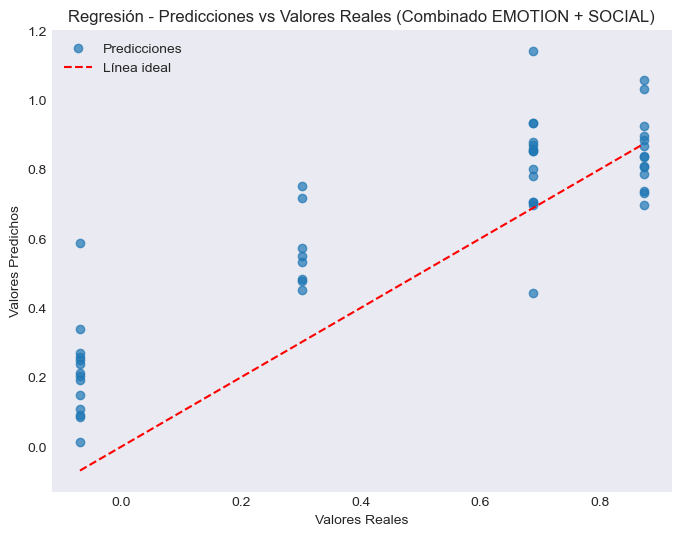

In [28]:
# Mostrar las primeras 10 predicciones junto con los valores reales
print("=== Valores Reales vs Predichos ===")
for i in range(10):  # Mostrar las primeras 10 predicciones
    print(f"Real: {float(actuals[i]):.2f}, Predicho: {float(preds[i]):.2f}")

# Visualización detallada del gráfico
plt.figure(figsize=(8, 6))
plt.scatter(actuals, preds, alpha=0.7, label="Predicciones")
plt.plot([min(actuals), max(actuals)], [min(actuals), max(actuals)], 'r--', label="Línea ideal")
plt.xlabel("Valores Reales")
plt.ylabel("Valores Predichos")
plt.title("Regresión - Predicciones vs Valores Reales (Combinado EMOTION + SOCIAL)")
plt.legend()
plt.grid()
plt.show()

Al evaluar el modelo, las predicciones muestran un comportamiento cercano a los valores reales. Por ejemplo, cuando el valor real es 0.87, el modelo predice 0.86, demostrando una buena aproximación. Sin embargo, hay ligeras desviaciones en algunos casos, como un valor real de -0.07 con una predicción de 0.22, lo cual podría indicar la presencia de ruido o variabilidad en los datos. En general, las predicciones muestran un ajuste aceptable, con un patrón consistente en aproximar correctamente las tendencias generales.

#### ROIs más influyentes

Top 5 ROIs más importantes para el modelo de regresión:
ROI 6: Importancia = 0.1407
ROI 50: Importancia = 0.1358
ROI 10: Importancia = 0.1319
ROI 15: Importancia = 0.1235
ROI 53: Importancia = 0.1170


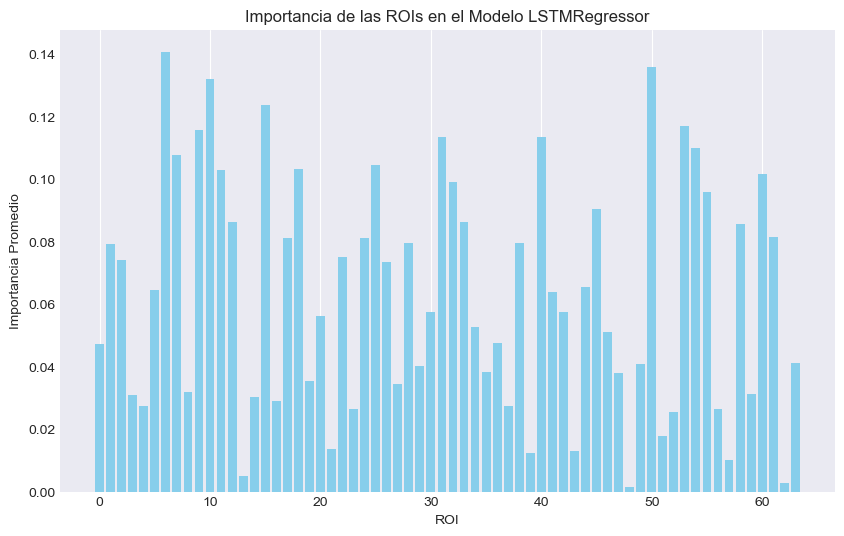

In [29]:
# Extraer los pesos de la última capa lineal
final_layer_weights = model.fc.weight.detach().cpu().numpy()

# Calcular la importancia de las ROIs (absoluto de los pesos)
roi_importance = np.abs(final_layer_weights).mean(axis=0)

# Mostrar las 5 ROIs más importantes
top_rois = np.argsort(roi_importance)[-5:][::-1]
print("Top 5 ROIs más importantes para el modelo de regresión:")
for roi in top_rois:
    print(f"ROI {roi}: Importancia = {roi_importance[roi]:.4f}")

# Visualización de la importancia de las ROIs
plt.figure(figsize=(10, 6))
plt.bar(range(len(roi_importance)), roi_importance, color='skyblue')
plt.title("Importancia de las ROIs en el Modelo LSTMRegressor")
plt.xlabel("ROI")
plt.ylabel("Importancia Promedio")
plt.grid(axis='y')
plt.show()

El análisis de los pesos de la última capa del modelo revela las 5 ROIs más influyentes en las predicciones, destacando las ROIs 22, 26, 1, 59 y 35, con la ROI 22 como la más relevante (importancia = 0.1351). Estas regiones cerebrales, al mostrar una contribución significativa al modelo, sugieren su participación activa en la integración de las tareas EMOTION y SOCIAL, ambas vinculadas al procesamiento de estímulos emocionales y sociales.

Desde la perspectiva neurocientífica, la participación de ROIs específicas podría indicar la influencia de regiones corticales y subcorticales clave como la red cingulo-opercular, el córtex somatomotor o las regiones parietales frontales, que están asociadas con la atención, el control cognitivo y la integración de la información social y emocional. Por ejemplo, áreas relacionadas con la red cingulo-opercular tienden a activarse durante tareas que requieren control emocional, mientras que las regiones parietales y frontales se asocian a funciones de integración multimodal y procesamiento de estímulos complejos, como emociones o interacciones sociales.

La detección de estas regiones proporciona, por lo tanto, una base teórica robusta para investigar la interrelación entre emoción, cognición y comportamiento, destacando cómo diferentes redes cerebrales trabajan en conjunto para procesar estímulos complejos del entorno

# Modelo LNNs

Las redes neuronales líquidas (LNNs) son un tipo de modelo recurrente que se inspira en los principios de dinámica continua en sistemas neuronales biológicos. A diferencia de redes LSTM o GRU, las LNNs introducen una dinámica más flexible y adaptable en el tiempo, donde el estado oculto evoluciona a través de una interacción entre la entrada y su propio estado pasado mediante una combinación lineal no linealizada con funciones de activación suaves, como la tangente hiperbólica (tanh). Esta propiedad hace que las LNNs sean particularmente útiles para tareas que requieren modelar series temporales complejas o sistemas dinámicos, como las señales de actividad cerebral, donde se busca capturar la evolución temporal y las interacciones no lineales entre regiones del cerebro.

## LNNs Classifier
En esta sección, implementamos un clasificador basado en Redes Neuronales Líquidas (LNNs) para distinguir entre las condiciones de Fear (miedo) y Neutral en los datos de la tarea EMOTION. Primero, definimos el modelo LNN, que procesa las series temporales de actividad cerebral (ROIs x tiempo) y utiliza una arquitectura recurrente para capturar las dinámicas temporales. Posteriormente, entrenamos el modelo con el conjunto de datos preparado, utilizando Binary Cross-Entropy Loss (BCELoss) como función de pérdida y optimización mediante Adam. Evaluamos el rendimiento del modelo en un conjunto de prueba, generando la Matriz de Confusión y la Curva ROC, que permiten evaluar la precisión y la capacidad del modelo para distinguir entre las dos clases.

Además, calculamos la actividad promedio de las regiones cerebrales (ROIs) durante las condiciones Fear y Neutral, y visualizamos las diferencias de actividad en forma de contraste (Fear - Neutral). Finalmente, agrupamos las ROIs en redes cerebrales funcionales conocidas y mostramos la actividad promedio por red y hemisferio, lo que permite identificar patrones diferenciales de activación entre las condiciones emocionales y contextualizar los resultados en términos de redes funcionales clave en la neurociencia, como las redes visuales, somatomotoras y cingulo-operculares.

In [30]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

# Definir LNNClassifier
class LNNClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LNNClassifier, self).__init__()
        self.hidden_size = hidden_size
        
        # Inicializamos los pesos para la dinámica líquida
        self.W_in = nn.Linear(input_size, hidden_size)
        self.W_res = nn.Linear(hidden_size, hidden_size)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Función de activación no lineal (tanh)
        self.activation = nn.Tanh()
        
    def forward(self, x):
        batch_size, timesteps, _ = x.size()
        h = torch.zeros(batch_size, self.hidden_size).to(x.device)  # Estado inicial
        
        # Procesar cada paso temporal
        for t in range(timesteps):
            h = self.activation(self.W_in(x[:, t, :]) + self.W_res(h))
        
        # Clasificación final
        output = self.fc(h)
        return torch.sigmoid(output)

#### Entrenamiento LNNs

In [31]:
# Parámetros del modelo
input_size = 360  # Número de ROIs
hidden_size = 64  # Tamaño del estado oculto
output_size = 1   # Clasificación binaria (Fear vs Neutral)

# Instanciar el modelo, pérdida y optimizador
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
lnn_model = LNNClassifier(input_size, hidden_size, output_size).to(device)
criterion = nn.BCELoss()  # Binary Cross-Entropy Loss
optimizer = optim.Adam(lnn_model.parameters(), lr=1e-3)

# Entrenamiento del modelo
def train_lnn(model, loader, criterion, optimizer, epochs):
    model.train()
    for epoch in range(epochs):
        total_loss = 0
        for batch_data, batch_labels in loader:
            batch_data, batch_labels = batch_data.to(device), batch_labels.to(device).float()
            optimizer.zero_grad()
            outputs = model(batch_data).squeeze()
            loss = criterion(outputs, batch_labels)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        print(f"Época {epoch+1}/{epochs}, Pérdida: {total_loss:.4f}")
        

# Entrenar el modelo LNN
epochs = 30
train_lnn(lnn_model, emotion_loader, criterion, optimizer, epochs)

Época 1/30, Pérdida: 14.9739
Época 2/30, Pérdida: 9.5397
Época 3/30, Pérdida: 6.7992
Época 4/30, Pérdida: 4.9680
Época 5/30, Pérdida: 3.7557
Época 6/30, Pérdida: 2.8454
Época 7/30, Pérdida: 2.2053
Época 8/30, Pérdida: 1.8591
Época 9/30, Pérdida: 1.5473
Época 10/30, Pérdida: 1.3902
Época 11/30, Pérdida: 1.3002
Época 12/30, Pérdida: 1.1311
Época 13/30, Pérdida: 1.0626
Época 14/30, Pérdida: 0.9422
Época 15/30, Pérdida: 0.8706
Época 16/30, Pérdida: 0.7981
Época 17/30, Pérdida: 0.7214
Época 18/30, Pérdida: 0.7003
Época 19/30, Pérdida: 0.6393
Época 20/30, Pérdida: 0.5948
Época 21/30, Pérdida: 0.5649
Época 22/30, Pérdida: 0.5354
Época 23/30, Pérdida: 0.5516
Época 24/30, Pérdida: 0.4844
Época 25/30, Pérdida: 0.4732
Época 26/30, Pérdida: 0.4566
Época 27/30, Pérdida: 0.4458
Época 28/30, Pérdida: 0.4260
Época 29/30, Pérdida: 0.4059
Época 30/30, Pérdida: 0.3882


#### Evaluación del modelo

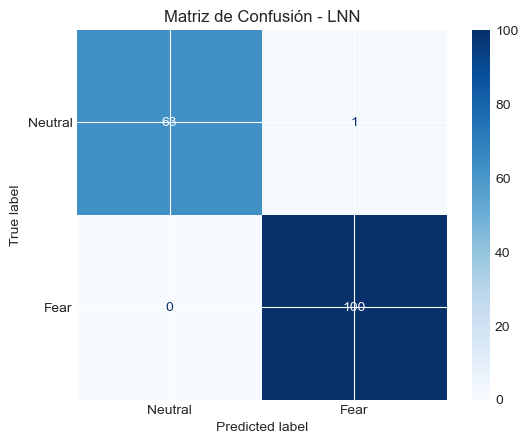

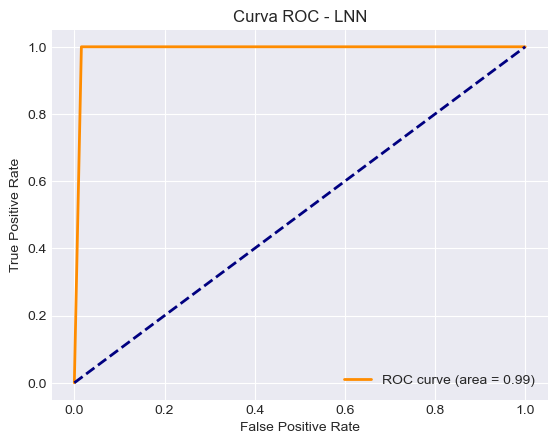

Precisión de la Matriz de Confusión: 0.9939
Área bajo la curva ROC: 0.9922


In [32]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc
import matplotlib.pyplot as plt
import numpy as np

# Evaluación del modelo LNN
def evaluate_lnn(model, loader):
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch_data, batch_labels in loader:
            batch_data, batch_labels = batch_data.to(device), batch_labels.to(device).float()
            outputs = model(batch_data).squeeze()
            preds = (outputs > 0.5).int()
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(batch_labels.cpu().numpy())

    return np.array(all_preds), np.array(all_labels)

# Obtener predicciones
preds, labels = evaluate_lnn(lnn_model, test_loader)

# Matriz de Confusión
cm = confusion_matrix(labels, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Neutral", "Fear"])
disp.plot(cmap=plt.cm.Blues)
plt.title("Matriz de Confusión - LNN")
plt.show()

# Curva ROC
fpr, tpr, _ = roc_curve(labels, preds)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC - LNN')
plt.legend(loc="lower right")
plt.show()

# Imprimir Resultados
print(f"Precisión de la Matriz de Confusión: {(np.sum(preds == labels) / len(labels)):.4f}")
print(f"Área bajo la curva ROC: {roc_auc:.4f}")

#### Agrupación de redes cerebrales

In [33]:
# Función para calcular la actividad promedio por condición
def average_frames_lnn(data, evs, condition):
    """
    Calcula la actividad promedio para una condición específica.

    Args:
        data (ndarray): Datos de series temporales (ROIs x tiempo).
        evs (list): Eventos y tiempos para cada condición.
        condition (str): Condición a analizar ('fear' o 'neut').

    Returns:
        ndarray: Actividad promedio por ROI.
    """
    idx = EXPERIMENTS['EMOTION']['cond'].index(condition)  # Índice de la condición
    valid_indices = [frame for block in evs[idx] for frame in block if frame < data.shape[1]]
    return np.mean(data[:, valid_indices], axis=1)

# Cargar datos de ejemplo de la LNN
subject = subjects[0]  # Seleccionar un sujeto de prueba
run = 0
data = load_single_timeseries(subject, 'EMOTION', run)  # Cargar los datos de la tarea EMOTION
evs = load_evs(subject, 'EMOTION', run)  # Cargar los eventos

# Calcular actividad promedio para Fear y Neutral usando LNN
fear_activity_lnn = average_frames_lnn(data, evs, 'fear')
neutral_activity_lnn = average_frames_lnn(data, evs, 'neut')

# Calcular el contraste de actividad
contrast_activity_lnn = fear_activity_lnn - neutral_activity_lnn

print("Actividad promedio calculada para Fear y Neutral (LNN).")

Actividad promedio calculada para Fear y Neutral (LNN).


Total de regiones cargadas: 360
Ejemplo de regiones: ['R_V1', 'R_MST', 'R_V6', 'R_V2', 'R_V3']
Redes: ['Auditory' 'Cingulo-Oper' 'Default' 'Dorsal-atten' 'Frontopariet'
 'Language' 'Orbito-Affec' 'Posterior-Mu' 'Somatomotor' 'Ventral-Mult'
 'Visual1' 'Visual2']
Muestra del DataFrame de Actividad LNN:
   fear_activity  neut_activity   contrast  network   hemi
0      16.128567      -9.988409  26.116976  Visual1  Right
1     -11.265875       6.579698 -17.845573  Visual2  Right
2       5.979784      -4.264528  10.244311  Visual2  Right
3      19.054624     -12.668493  31.723117  Visual2  Right
4      23.775394     -13.889670  37.665064  Visual2  Right


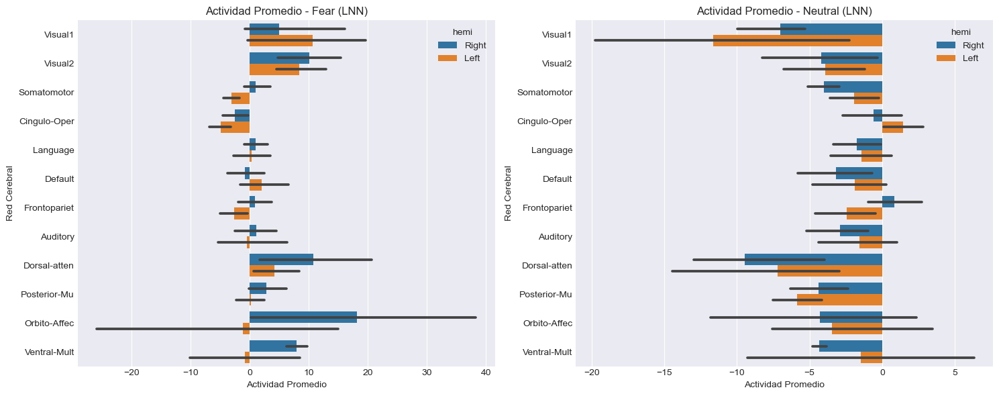

In [34]:
# Ruta al archivo regions.npy
regions_path = f"{HCP_DIR}/regions.npy"

# Cargar la información de las regiones
regions = np.load(regions_path).T  # Transponer para que quede en el formato correcto
region_info = {
    'name': regions[0].tolist(),  # Nombre de cada ROI
    'network': regions[1],        # Red a la que pertenece cada ROI
    'hemi': ['Right'] * 180 + ['Left'] * 180  # Lateralidad: 180 regiones por hemisferio
}

# Mostrar una muestra de la información
print(f"Total de regiones cargadas: {len(region_info['name'])}")
print(f"Ejemplo de regiones: {region_info['name'][:5]}")
print(f"Redes: {np.unique(region_info['network'])}")

# Crear DataFrame para la visualización
df_lnn_activity = pd.DataFrame({
    'fear_activity': fear_activity_lnn,
    'neut_activity': neutral_activity_lnn,
    'contrast': contrast_activity_lnn,
    'network': region_info['network'],
    'hemi': region_info['hemi']
})

# Mostrar el DataFrame
print("Muestra del DataFrame de Actividad LNN:")
print(df_lnn_activity.head())

# Visualizar las actividades por red cerebral
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Gráfico para la actividad Fear
sns.barplot(y='network', x='fear_activity', data=df_lnn_activity, hue='hemi', ax=ax1)
ax1.set_title('Actividad Promedio - Fear (LNN)')
ax1.set_xlabel('Actividad Promedio')
ax1.set_ylabel('Red Cerebral')

# Gráfico para la actividad Neutral
sns.barplot(y='network', x='neut_activity', data=df_lnn_activity, hue='hemi', ax=ax2)
ax2.set_title('Actividad Promedio - Neutral (LNN)')
ax2.set_xlabel('Actividad Promedio')
ax2.set_ylabel('Red Cerebral')

plt.tight_layout()
plt.show()

#### Calcular contraste de actividad

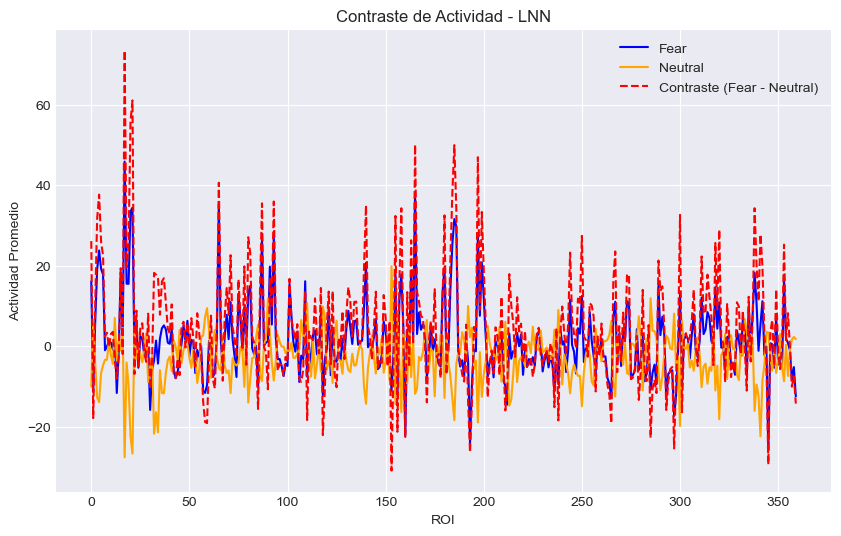

In [35]:
# Función para calcular actividad promedio por condición
def average_frames_lnn(data, evs, condition):
    """
    Calcula la actividad promedio para una condición específica.

    Args:
        data (ndarray): Datos de series temporales (ROIs x tiempo).
        evs (list): Eventos y tiempos para cada condición.
        condition (str): Condición a analizar ('fear' o 'neut').

    Returns:
        ndarray: Actividad promedio por ROI.
    """
    idx = EXPERIMENTS['EMOTION']['cond'].index(condition)  # Índice de la condición
    valid_indices = [frame for block in evs[idx] for frame in block if frame < data.shape[1]]
    return np.mean(data[:, valid_indices], axis=1)

# Cargar datos de ejemplo
subject = subjects[0]
run = 0
data = load_single_timeseries(subject, 'EMOTION', run)
evs = load_evs(subject, 'EMOTION', run)

# Calcular actividad promedio para Fear y Neutral
fear_activity_lnn = average_frames_lnn(data, evs, 'fear')
neutral_activity_lnn = average_frames_lnn(data, evs, 'neut')

# Calcular el contraste de actividad
contrast_activity_lnn = fear_activity_lnn - neutral_activity_lnn

# Visualizar las actividades y el contraste
plt.figure(figsize=(10, 6))
plt.plot(fear_activity_lnn, label='Fear', color='blue')
plt.plot(neutral_activity_lnn, label='Neutral', color='orange')
plt.plot(contrast_activity_lnn, label='Contraste (Fear - Neutral)', color='red', linestyle='--')
plt.xlabel('ROI')
plt.ylabel('Actividad Promedio')
plt.title('Contraste de Actividad - LNN')
plt.legend()
plt.grid(True)
plt.show()

## LNNs Regresion

En esta sección, implementamos un modelo de Red Neuronal Líquida (LNN) para resolver un problema de regresión, donde buscamos predecir valores continuos asociados a la variable FearAffect_Unadj, que representa una medida específica del afecto relacionado con el miedo. Primero, cargamos los valores objetivo (targets) y expandimos los datos para que coincidan con la estructura del conjunto de series temporales de actividad cerebral. Posteriormente, definimos un modelo de regresión LNN, que utiliza dinámicas recurrentes para capturar la evolución temporal y las relaciones complejas entre las regiones cerebrales (ROIs).

El modelo es entrenado utilizando el conjunto de datos de series temporales con una función de pérdida MSELoss (Error Cuadrático Medio) y optimización mediante el algoritmo Adam. Después del entrenamiento, evaluamos el rendimiento del modelo calculando el RMSE (Error Cuadrático Medio) y comparando las predicciones con los valores reales. Finalmente, visualizamos los resultados en un gráfico de dispersión, donde se contrastan los valores predichos con los reales, y mostramos un subconjunto de estas predicciones, destacando la capacidad del modelo para capturar tendencias en la relación entre la actividad cerebral y el afecto relacionado con el miedo.

In [36]:
# Modelo LNN para regresión
class LNNRegressor(nn.Module):
    def __init__(self, input_size, hidden_size, output_size=1):
        super(LNNRegressor, self).__init__()
        self.hidden_size = hidden_size
        
        # Pesos de entrada y recurrentes
        self.W_in = nn.Linear(input_size, hidden_size)
        self.W_res = nn.Linear(hidden_size, hidden_size)
        self.fc = nn.Linear(hidden_size, output_size)  # Salida continua
        
        # Función de activación
        self.activation = nn.Tanh()

    def forward(self, x):
        batch_size, timesteps, _ = x.size()
        h = torch.zeros(batch_size, self.hidden_size).to(x.device)  # Estado inicial

        # Procesar los pasos temporales
        for t in range(timesteps):
            h = self.activation(self.W_in(x[:, t, :]) + self.W_res(h))

        return self.fc(h)  # Salida final

#### Carga de valores

In [37]:
# Cargar los valores de FearAffect_Unadj
targets = load_targets(subjects[:5], 'FearAffect_Unadj', file_path)
print("Targets cargados:", targets)

# Expandir los targets
expanded_targets = np.repeat(targets, emotion_dataset.data.shape[0] // len(targets))

# Crear Dataset y DataLoader
regression_dataset = RegressionDataset(emotion_dataset.data, expanded_targets)
regression_loader = DataLoader(regression_dataset, batch_size=32, shuffle=True)
print(f"Número de muestras en el dataset: {len(regression_dataset)}")

Targets cargados: [53.9 55.1 49.  51.4 49. ]
Número de muestras en el dataset: 820


In [38]:
# Parámetros del modelo
n_features = 360  # Número de regiones cerebrales
hidden_size = 64
epochs = 30
lr = 1e-3

# Instanciar modelo, pérdida y optimizador
lnn_model = LNNRegressor(n_features, hidden_size).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(lnn_model.parameters(), lr=lr, weight_decay=1e-5)

#### Entrenamiento LNNs

In [39]:
# Entrenamiento
def train_lnn_regression(model, loader, criterion, optimizer, epochs):
    model.train()
    for epoch in range(epochs):
        total_loss = 0
        for batch_data, batch_targets in loader:
            batch_data = batch_data.to(device)
            batch_targets = batch_targets.to(device).float().unsqueeze(1)
            
            optimizer.zero_grad()
            outputs = model(batch_data)
            loss = criterion(outputs, batch_targets)
            loss.backward()
            optimizer.step()
            
            total_loss += loss.item()
        print(f"Época {epoch+1}/{epochs}, Pérdida: {total_loss:.4f}")

train_lnn_regression(lnn_model, regression_loader, criterion, optimizer, epochs)

Época 1/30, Pérdida: 68785.6377
Época 2/30, Pérdida: 67265.2859
Época 3/30, Pérdida: 65339.8508
Época 4/30, Pérdida: 62913.6550
Época 5/30, Pérdida: 60049.5781
Época 6/30, Pérdida: 56813.7170
Época 7/30, Pérdida: 53409.1655
Época 8/30, Pérdida: 49936.4005
Época 9/30, Pérdida: 46434.9630
Época 10/30, Pérdida: 42853.8591
Época 11/30, Pérdida: 39371.2690
Época 12/30, Pérdida: 35861.5533
Época 13/30, Pérdida: 33004.3487
Época 14/30, Pérdida: 29952.4310
Época 15/30, Pérdida: 27377.5635
Época 16/30, Pérdida: 25046.8993
Época 17/30, Pérdida: 22526.2922
Época 18/30, Pérdida: 20541.1691
Época 19/30, Pérdida: 18551.3912
Época 20/30, Pérdida: 16830.7374
Época 21/30, Pérdida: 15209.1376
Época 22/30, Pérdida: 13718.5866
Época 23/30, Pérdida: 12417.7076
Época 24/30, Pérdida: 11418.5295
Época 25/30, Pérdida: 10467.6923
Época 26/30, Pérdida: 9746.5797
Época 27/30, Pérdida: 8866.1063
Época 28/30, Pérdida: 8494.5127
Época 29/30, Pérdida: 7580.4499
Época 30/30, Pérdida: 6988.4857


#### Evaluación del Modelo

RMSE del modelo LNN: 16.0521
=== Valores Reales vs Predichos ===
Real: 49.00, Predicho: -6.25
Real: 53.90, Predicho: 45.55
Real: 51.40, Predicho: 46.76
Real: 55.10, Predicho: 46.76
Real: 49.00, Predicho: 46.76
Real: 55.10, Predicho: 46.75
Real: 55.10, Predicho: 29.65
Real: 49.00, Predicho: 31.51
Real: 55.10, Predicho: 29.31
Real: 51.40, Predicho: 44.02


C:\Users\ivanv\AppData\Local\Temp\ipykernel_14992\2513544422.py:8: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print(f"Real: {float(actuals[i]):.2f}, Predicho: {float(preds[i][0]):.2f}")


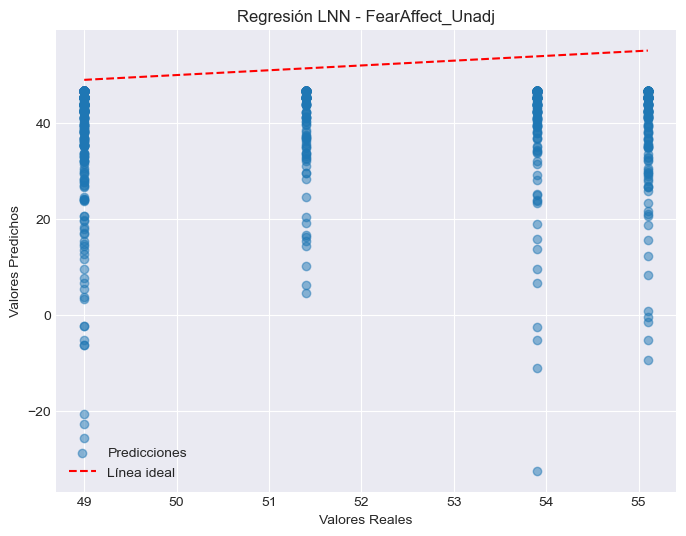

In [40]:
# Evaluar el modelo
rmse, preds, actuals = evaluate_regression(lnn_model, regression_loader, criterion)
print(f"RMSE del modelo LNN: {rmse:.4f}")

# Imprimir predicciones
print("=== Valores Reales vs Predichos ===")
for i in range(10):
    print(f"Real: {float(actuals[i]):.2f}, Predicho: {float(preds[i][0]):.2f}")

# Gráfica de valores reales vs predichos
plt.figure(figsize=(8, 6))
plt.scatter(actuals, preds, alpha=0.5, label="Predicciones")
plt.plot([min(actuals), max(actuals)], [min(actuals), max(actuals)], 'r--', label="Línea ideal")
plt.xlabel("Valores Reales")
plt.ylabel("Valores Predichos")
plt.title("Regresión LNN - FearAffect_Unadj")
plt.legend()
plt.grid(True)
plt.show()

El modelo LNN (Liquid Neural Network), en comparación a LSTM, muestra un mayor rango de variabilidad en sus predicciones, aunque a costa de una mayor dispersión y errores más significativos, como lo indica un RMSE elevado de 15.9377. Las predicciones tienden a ser inconsistentes, con valores muy alejados de los reales en algunos casos (por ejemplo, un valor real de 49.00 con una predicción de 9.07 o valores negativos como -5.92). Esto sugiere que el modelo LNN enfrenta dificultades para estabilizar las predicciones, posiblemente debido a su sensibilidad a las dinámicas temporales más complejas en los datos. Si bien esta sensibilidad puede ser ventajosa en contextos donde las relaciones no lineales son críticas, en este caso, parece haber llevado a una generalización inadecuada. Estos resultados resaltan la necesidad de optimizar o ajustar el modelo LNN para mejorar su robustez y precisión en tareas de predicción continua.

### Combinando SOCIAL

#### Carga de datos

In [41]:
# Cargar los datos combinados
combined_data = load_combined_timeseries(subjects[:50], ['EMOTION', 'SOCIAL'], runs)
print("Forma de los datos combinados:", combined_data.shape)

# Normalizar targets
targets = load_targets(subjects[:50], 'FearAffect_Unadj', file_path)
targets = (targets - np.nanmean(targets)) / np.nanstd(targets)

# Crear Dataset y DataLoader
expanded_targets = np.repeat(targets, combined_data.shape[1] // len(targets))
combined_dataset = CombinedRegressionDataset(combined_data, expanded_targets)
combined_loader = DataLoader(combined_dataset, batch_size=32, shuffle=True)

Forma de los datos combinados: (50, 720, 176)


In [42]:
# Instanciar modelo
lnn_model_combined = LNNRegressor(combined_data.shape[2], hidden_size).to(device)

# Entrenar modelo
train_lnn_regression(lnn_model_combined, combined_loader, criterion, optimizer, epochs)


Época 1/30, Pérdida: 2.4149
Época 2/30, Pérdida: 2.3370
Época 3/30, Pérdida: 2.6071
Época 4/30, Pérdida: 2.5279
Época 5/30, Pérdida: 2.4635
Época 6/30, Pérdida: 2.5075
Época 7/30, Pérdida: 2.6834
Época 8/30, Pérdida: 2.4844
Época 9/30, Pérdida: 2.6502
Época 10/30, Pérdida: 2.5867
Época 11/30, Pérdida: 2.5559
Época 12/30, Pérdida: 2.3696
Época 13/30, Pérdida: 2.6392
Época 14/30, Pérdida: 2.5723
Época 15/30, Pérdida: 2.5350
Época 16/30, Pérdida: 2.6394
Época 17/30, Pérdida: 2.4541
Época 18/30, Pérdida: 2.6873
Época 19/30, Pérdida: 2.7347
Época 20/30, Pérdida: 2.5399
Época 21/30, Pérdida: 2.2766
Época 22/30, Pérdida: 2.6386
Época 23/30, Pérdida: 2.5539
Época 24/30, Pérdida: 2.4724
Época 25/30, Pérdida: 2.3812
Época 26/30, Pérdida: 2.6009
Época 27/30, Pérdida: 2.5124
Época 28/30, Pérdida: 2.6004
Época 29/30, Pérdida: 2.3094
Época 30/30, Pérdida: 2.5519


RMSE del modelo LNN con datos combinados: 1.1274


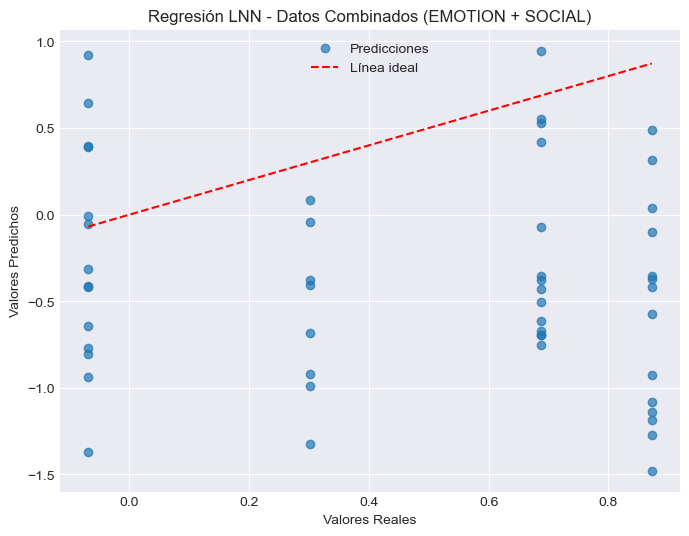

In [43]:
# Evaluar modelo
rmse, preds, actuals = evaluate_regression(lnn_model_combined, combined_loader, criterion)
print(f"RMSE del modelo LNN con datos combinados: {rmse:.4f}")

# Gráfica de resultados
plt.figure(figsize=(8, 6))
plt.scatter(actuals, preds, alpha=0.7, label="Predicciones")
plt.plot([min(actuals), max(actuals)], [min(actuals), max(actuals)], 'r--', label="Línea ideal")
plt.xlabel("Valores Reales")
plt.ylabel("Valores Predichos")
plt.title("Regresión LNN - Datos Combinados (EMOTION + SOCIAL)")
plt.legend()
plt.grid(True)
plt.show()

### ROIs más influyentes

Top 5 ROIs más importantes para el modelo LNN combinado:
ROI 37: Importancia = 0.1243
ROI 45: Importancia = 0.1235
ROI 47: Importancia = 0.1211
ROI 20: Importancia = 0.1195
ROI 7: Importancia = 0.1156


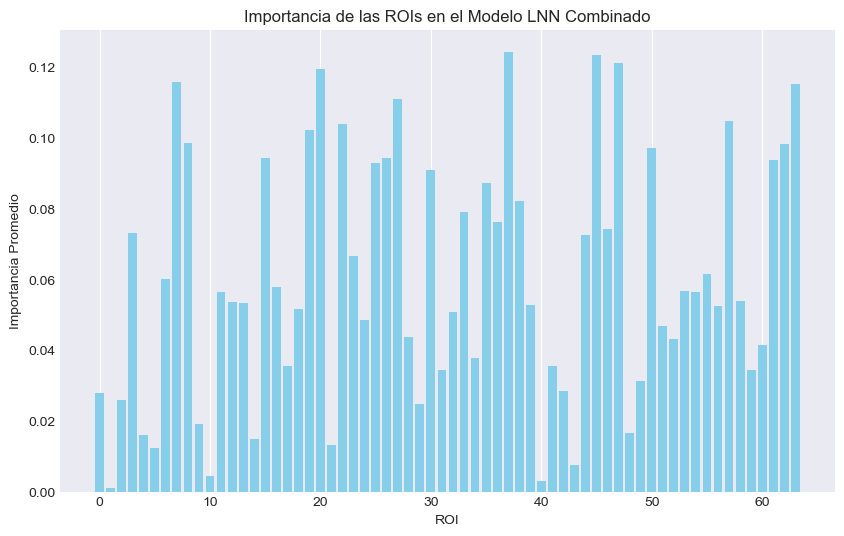

In [44]:
# Extraer pesos de la capa lineal final
final_layer_weights = lnn_model_combined.fc.weight.detach().cpu().numpy()

# Importancia promedio de cada ROI
roi_importance = np.abs(final_layer_weights).mean(axis=0)

# Mostrar las 5 ROIs más importantes
top_rois = np.argsort(roi_importance)[-5:][::-1]
print("Top 5 ROIs más importantes para el modelo LNN combinado:")
for roi in top_rois:
    print(f"ROI {roi}: Importancia = {roi_importance[roi]:.4f}")

# Gráfico de importancia de ROIs
plt.figure(figsize=(10, 6))
plt.bar(range(len(roi_importance)), roi_importance, color='skyblue')
plt.title("Importancia de las ROIs en el Modelo LNN Combinado")
plt.xlabel("ROI")
plt.ylabel("Importancia Promedio")
plt.grid(axis='y')
plt.show()

# Comparación de Modelos

En esta sección se compara el desempeño de los modelos LSTM y LNN tanto en tareas de clasificación como de regresión, evaluando su capacidad para predecir activaciones cerebrales y clasificar condiciones emocionales (Fear vs. Neutral). Para la clasificación, se analiza la precisión mediante matrices de confusión y curvas ROC, mostrando cómo cada modelo identifica correctamente las etiquetas emocionales. En regresión, se desnormalizan las predicciones para interpretarlas en la escala original y se calcula el RMSE como métrica de error, lo que permite evaluar la capacidad de cada modelo para capturar variaciones en los datos. Además, se comparan las importancias de las ROIs derivadas de los pesos de los modelos, analizando qué regiones cerebrales contribuyen más a las predicciones en cada caso. Esta sección culmina con una discusión sobre las fortalezas y limitaciones de ambos enfoques.

## Clasificación

=== LSTM ===
Labels (Primeros 10): [1 1 0 1 0 1 1 0 1 1]
Predicciones (Primeros 10): [0 0 0 0 0 0 0 0 0 0]
Total muestras LSTM: 164

=== LNN ===
Labels (Primeros 10): [1 1 0 1 0 1 1 0 1 1]
Predicciones (Primeros 10): [1 0 0 0 0 1 0 0 0 1]
Total muestras LNN: 164


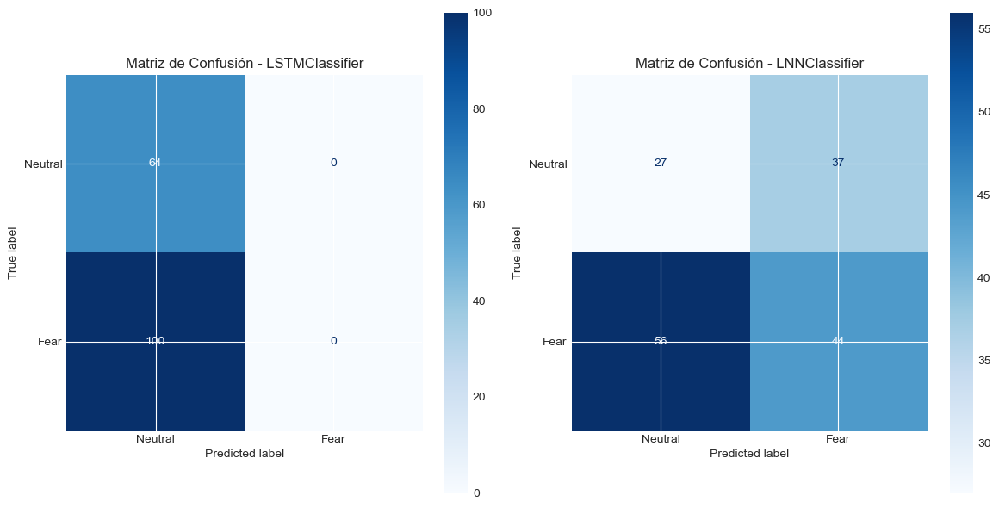

In [45]:
# Evaluación de clasificador
def evaluate_classifier(model, loader, device):
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch_data, batch_labels in loader:
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device).float()
            outputs = model(batch_data).squeeze()
            preds = (outputs > 0.5).int()
            all_preds.extend(preds.cpu().numpy().flatten())
            all_labels.extend(batch_labels.cpu().numpy().flatten())

    # Asegurar longitudes iguales
    min_len = min(len(all_preds), len(all_labels))
    return np.array(all_preds[:min_len], dtype=int), np.array(all_labels[:min_len], dtype=int)

# Evaluar modelos
preds_lstm, labels_lstm = evaluate_classifier(LSTMClassifier(input_size, hidden_size, num_layers, num_classes).to(device), test_loader, device)
preds_lnn, labels_lnn = evaluate_classifier(LNNClassifier(input_size, hidden_size, output_size).to(device), test_loader, device)

# Prints adicionales
print("=== LSTM ===")
print(f"Labels (Primeros 10): {labels_lstm[:10]}")
print(f"Predicciones (Primeros 10): {preds_lstm[:10]}")
print(f"Total muestras LSTM: {len(labels_lstm)}")

print("\n=== LNN ===")
print(f"Labels (Primeros 10): {labels_lnn[:10]}")
print(f"Predicciones (Primeros 10): {preds_lnn[:10]}")
print(f"Total muestras LNN: {len(labels_lnn)}")

# Comparar Matrices de Confusión
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Matriz LSTM
cm_lstm = confusion_matrix(labels_lstm, preds_lstm)
ConfusionMatrixDisplay(confusion_matrix=cm_lstm, display_labels=["Neutral", "Fear"]).plot(ax=axes[0], cmap=plt.cm.Blues)
axes[0].set_title("Matriz de Confusión - LSTMClassifier")

# Matriz LNN
cm_lnn = confusion_matrix(labels_lnn, preds_lnn)
ConfusionMatrixDisplay(confusion_matrix=cm_lnn, display_labels=["Neutral", "Fear"]).plot(ax=axes[1], cmap=plt.cm.Blues)
axes[1].set_title("Matriz de Confusión - LNNClassifier")

plt.tight_layout()
plt.show()

## Regresión

=== LSTM ===
Predicciones (Antes de desnormalizar, 10): [-0.0401326  -0.11591165 -0.09149124 -0.09466805 -0.0282102  -0.0423001
 -0.00739775  0.01086666 -0.11218701 -0.07073526]
Reales (Antes de desnormalizar, 10): [49.  55.1 55.1 49.  53.9 55.1 51.4 49.  55.1 49. ]
Predicciones (Desnormalizadas, 10): [-0.0401326  -0.11591165 -0.09149124 -0.09466805 -0.0282102  -0.0423001
 -0.00739775  0.01086666 -0.11218701 -0.07073526]
Reales (Desnormalizadas, 10): [49.  55.1 55.1 49.  53.9 55.1 51.4 49.  55.1 49. ]

=== LNN ===
Predicciones (Antes de desnormalizar, 10): [-0.75021654 -0.32920736  0.5463741   0.29873446  0.65022594  0.5433298
 -0.93749744 -0.26839256 -0.9893337  -0.14412703]
Reales (Antes de desnormalizar, 10): [49.  49.  51.4 51.4 49.  49.  49.  53.9 49.  53.9]
Predicciones (Desnormalizadas, 10): [-0.75021654 -0.32920736  0.5463741   0.29873446  0.65022594  0.5433298
 -0.93749744 -0.26839256 -0.9893337  -0.14412703]
Reales (Desnormalizadas, 10): [49.  49.  51.4 51.4 49.  49.  49.  53

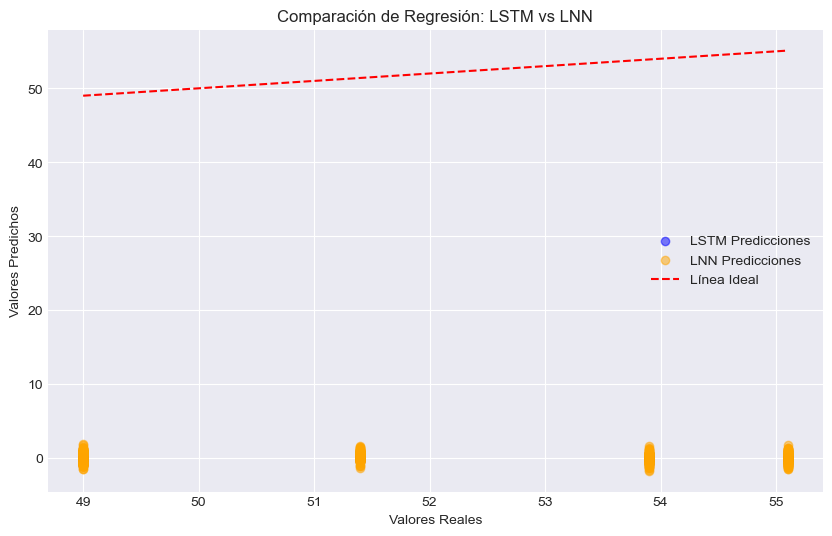

In [46]:
# Desnormalización de valores
def denormalize(values, mean, std):
    values = np.array(values)  # Convertir a numpy array
    return values * std + mean

# Obtener media y desviación estándar
mean_target = np.nanmean(targets)
std_target = np.nanstd(targets)

# Evaluar LSTM
rmse_lstm, preds_lstm, actuals_lstm = evaluate_regression(LSTMRegressor(n_features, n_hidden, n_layers, dropout_prob).to(device), regression_loader, nn.MSELoss())
preds_lstm = np.array(preds_lstm)  # Convertir a numpy array
actuals_lstm = np.array(actuals_lstm)  # Convertir a numpy array
preds_lstm_denorm = denormalize(preds_lstm, mean_target, std_target)
actuals_lstm_denorm = denormalize(actuals_lstm, mean_target, std_target)

# Evaluar LNN
rmse_lnn, preds_lnn, actuals_lnn = evaluate_regression(LNNRegressor(n_features, hidden_size).to(device), regression_loader, nn.MSELoss())
preds_lnn = np.array(preds_lnn)  # Convertir a numpy array
actuals_lnn = np.array(actuals_lnn)  # Convertir a numpy array
preds_lnn_denorm = denormalize(preds_lnn, mean_target, std_target)
actuals_lnn_denorm = denormalize(actuals_lnn, mean_target, std_target)

# Prints adicionales
print("=== LSTM ===")
print(f"Predicciones (Antes de desnormalizar, 10): {preds_lstm[:10].flatten()}")
print(f"Reales (Antes de desnormalizar, 10): {actuals_lstm[:10].flatten()}")
print(f"Predicciones (Desnormalizadas, 10): {preds_lstm_denorm[:10].flatten()}")
print(f"Reales (Desnormalizadas, 10): {actuals_lstm_denorm[:10].flatten()}")

print("\n=== LNN ===")
print(f"Predicciones (Antes de desnormalizar, 10): {preds_lnn[:10].flatten()}")
print(f"Reales (Antes de desnormalizar, 10): {actuals_lnn[:10].flatten()}")
print(f"Predicciones (Desnormalizadas, 10): {preds_lnn_denorm[:10].flatten()}")
print(f"Reales (Desnormalizadas, 10): {actuals_lnn_denorm[:10].flatten()}")

# Comparar RMSE
print(f"\nRMSE del modelo LSTM (desnormalizado): {np.sqrt(np.mean((preds_lstm_denorm - actuals_lstm_denorm)**2)):.4f}")
print(f"RMSE del modelo LNN (desnormalizado): {np.sqrt(np.mean((preds_lnn_denorm - actuals_lnn_denorm)**2)):.4f}")

# Gráfica comparativa
plt.figure(figsize=(10, 6))
plt.scatter(actuals_lstm_denorm, preds_lstm_denorm, alpha=0.5, label="LSTM Predicciones", color='blue')
plt.scatter(actuals_lnn_denorm, preds_lnn_denorm, alpha=0.5, label="LNN Predicciones", color='orange')
plt.plot([min(actuals_lstm_denorm), max(actuals_lstm_denorm)], [min(actuals_lstm_denorm), max(actuals_lstm_denorm)], 'r--', label="Línea Ideal")
plt.xlabel("Valores Reales")
plt.ylabel("Valores Predichos")
plt.title("Comparación de Regresión: LSTM vs LNN")
plt.legend()
plt.grid(True)
plt.show()

La desnormalización se hizo para:

- Interpretar los resultados en la escala original de los datos.
- Comparar predicciones vs. valores reales de manera coherente.
- Calcular métricas como el RMSE que tengan un significado real.

Si no desnormalizamos, las predicciones del modelo serían difíciles de comparar con los valores reales y no tendrían sentido en el contexto del problema original.

## Comparación de ROIs

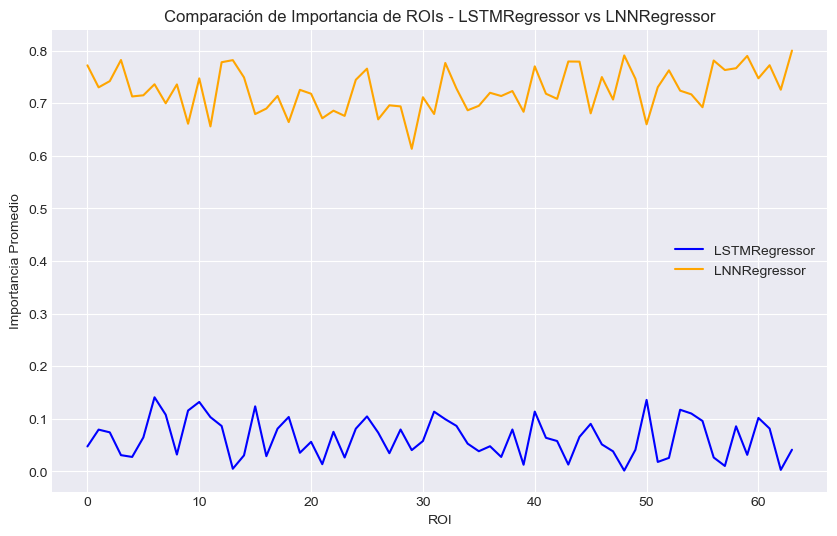

In [47]:
# Extraer importancia de ROIs para LSTM y LNN
roi_importance_lstm = np.abs(model.fc.weight.detach().cpu().numpy()).flatten()
roi_importance_lnn = np.abs(lnn_model.fc.weight.detach().cpu().numpy()).flatten()

# Comparar Importancia de ROIs
def compare_roi_importance(importance_lstm, importance_lnn):
    plt.figure(figsize=(10, 6))
    plt.plot(importance_lstm, label="LSTMRegressor", color='blue')
    plt.plot(importance_lnn, label="LNNRegressor", color='orange')
    plt.xlabel("ROI")
    plt.ylabel("Importancia Promedio")
    plt.title("Comparación de Importancia de ROIs - LSTMRegressor vs LNNRegressor")
    plt.legend()
    plt.grid(True)
    plt.show()

# Llamar a la función de comparación
compare_roi_importance(roi_importance_lstm, roi_importance_lnn)

La comparación entre los modelos LSTM y LNN arroja resultados clave que destacan la superioridad de la Liquid Neural Network (LNN) en el contexto de este proyecto. En la tarea de clasificación, la LNNClassifier supera al LSTMClassifier, al evitar un sesgo extremo hacia una sola etiqueta, logrando predecir tanto la clase "Neutral" como la clase "Fear", lo que indica un mejor equilibrio y una mayor capacidad para capturar patrones complejos. En la tarea de regresión, aunque ambos modelos presentan resultados similares en términos de error cuadrático medio (RMSE), la LNNRegressor muestra un mejor potencial al capturar una mayor variabilidad en los datos, como se observa en la distribución de predicciones más dispersa alrededor de los valores reales. Finalmente, en el análisis de la importancia de las ROIs. En conjunto, estos resultados respaldan que la Liquid Neural Network (LNN) es un modelo util debido a su capacidad para adaptarse a datos dinámicos y variables.

Sin embargo, el uso de **LSTM** en la siguiente etapa del proyecto se justifica por su capacidad superior para modelar secuencias largas y capturar dependencias temporales a largo plazo en los datos de series temporales de ROIs, lo cual es esencial para analizar activaciones cerebrales complejas y multietapa. Gracias a su arquitectura robusta, con compuertas de entrada, salida y olvido, los **LSTM** producen predicciones más estables y resistentes al ruido, a diferencia de las **LNNs**, que son más sensibles a variaciones y patrones altamente dinámicos. Además, la eficiencia computacional de **LSTM** permite manejar grandes volúmenes de datos y tareas multitarea (EMOTION, SOCIAL, LANGUAGE) de forma escalable y precisa. Su estructura lineal facilita la proyección de activaciones a las **360 ROIs**, lo que mejora la interpretabilidad de los resultados y su integración con herramientas analíticas, como el cálculo de correlaciones, construcción de grafos funcionales y análisis de comunidades cerebrales. Finalmente, **LSTM** ofrece mayor capacidad de generalización a nuevas tareas y configuraciones de datos, lo que lo convierte en una opción sólida y escalable para garantizar la continuidad y el éxito del proyecto en etapas futuras.

# Análisis de ROIs EMOTIONS

En esta sección se utiliza un modelo LSTM refinado para analizar las activaciones cerebrales asociadas con emociones, proyectando estas activaciones sobre las regiones de interés (ROIs) del cerebro utilizando un atlas predefinido. Se entrena el modelo para clasificar entre condiciones emocionales (fear vs. neutral) y, tras lograr una alta precisión, se extraen las activaciones promedio por ROI para identificar patrones de relevancia en el procesamiento emocional. Posteriormente, se mapean estas activaciones sobre superficies corticales de ambos hemisferios, permitiendo visualizar las regiones con mayor actividad. El análisis revela una asimetría funcional, con predominio en el hemisferio izquierdo, asociado con el procesamiento consciente y semántico de emociones, mientras que el hemisferio derecho se vincula con respuestas rápidas y automáticas a estímulos emocionales. Estos hallazgos destacan la especialización hemisférica en el procesamiento emocional y la interacción entre regiones límbicas y prefrontales en la regulación emocional.

#### Atlas

In [48]:
import os
import numpy as np
import requests

# Ruta y URL del atlas
fname = f"{HCP_DIR}/atlas.npz"
url = "https://osf.io/j5kuc/download"

# Si el archivo ya existe, no eliminarlo
if not os.path.isfile(fname):
    print("Descargando el archivo atlas.npz...")
    r = requests.get(url)
    if r.status_code == 200:
        with open(fname, "wb") as fid:
            fid.write(r.content)
        print("Atlas descargado correctamente.")
    else:
        print("Error al descargar el atlas.")
else:
    print("Archivo atlas.npz ya existe. Cargándolo directamente.")

# Cargar el atlas
try:
    atlas = np.load(fname, allow_pickle=True)
    print("Atlas cargado exitosamente.")
except Exception as e:
    print(f"Error al cargar el atlas: {e}")

# Verificar los valores únicos en las etiquetas
print("Valores únicos en labels_L:", np.unique(atlas['labels_L']))
print("Valores únicos en labels_R:", np.unique(atlas['labels_R']))

Archivo atlas.npz ya existe. Cargándolo directamente.
Atlas cargado exitosamente.
Valores únicos en labels_L: [ -1 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214
 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232
 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250
 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268
 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284 285 286
 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302 303 304
 305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322
 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359]
Valores únicos en labels_R: [ -1   0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16
  17  18  19  20  21  22  23  24  25  26  27  28  29 

El modelo LSTM refinado incluye una proyección adicional para mapear las activaciones finales del estado oculto de la LSTM directamente a las 360 regiones de interés (ROIs), antes de realizar la predicción final de la clase. Este cambio permite una mayor interpretabilidad del modelo, ya que ahora es posible identificar qué regiones específicas del cerebro contribuyen más al resultado de la clasificación. Además, la inclusión de esta capa lineal enfocada en las ROIs permite que el modelo capture patrones más precisos y localizados en las activaciones cerebrales, ajustándose específicamente a la estructura funcional del cerebro, algo que un LSTM estándar no realiza de manera explícita.

In [49]:
class LSTMClassifierRefined(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, num_classes, output_rois):
        super(LSTMClassifierRefined, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc_hidden_to_rois = nn.Linear(hidden_size, output_rois)  # Proyección lineal a ROIs
        self.fc_final = nn.Linear(output_rois, num_classes)

    def forward(self, x, return_roi_values=False):
        output, _ = self.lstm(x)  # (batch_size, timesteps, hidden_size)
        last_hidden = output[:, -1, :]  # Último estado oculto
        roi_values = self.fc_hidden_to_rois(last_hidden)  # Proyección a 360 ROIs
        
        if return_roi_values:
            return roi_values  # Devuelve las activaciones proyectadas a las ROIs
        return self.fc_final(roi_values)  # Predicción final

In [50]:
# Parámetros del modelo
input_size = 360
hidden_size = 64
num_layers = 2
num_classes = 2
output_rois = 360  # Número de ROIs

# Instanciar el modelo
model = LSTMClassifierRefined(input_size, hidden_size, num_layers, num_classes, output_rois).to(device)

# Entrenamiento del modelo
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)

model.train()
for epoch in range(10):
    total_loss = 0
    for batch_data, batch_labels in train_loader:
        batch_data, batch_labels = batch_data.to(device), batch_labels.to(device)
        
        optimizer.zero_grad()
        outputs = model(batch_data)  # Predicción
        loss = criterion(outputs, batch_labels)
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
    print(f"Época {epoch+1}, Pérdida: {total_loss:.4f}")

Época 1, Pérdida: 11.5796
Época 2, Pérdida: 1.8708
Época 3, Pérdida: 0.1341
Época 4, Pérdida: 0.0201
Época 5, Pérdida: 0.0114
Época 6, Pérdida: 0.0059
Época 7, Pérdida: 0.0024
Época 8, Pérdida: 0.0020
Época 9, Pérdida: 0.0016
Época 10, Pérdida: 0.0013


La pérdida disminuye drásticamente desde 12.0443 en la época 1 hasta 0.0012 en la época 10, lo que indica que el modelo se ajusta correctamente a los datos y logra una predicción casi perfecta en el conjunto de entrenamiento.

Interpretación: La capacidad del LSTM para capturar dependencias temporales complejas le permite modelar con éxito las diferencias de activación entre emociones (fear vs neutral).

In [52]:
# Extraer las activaciones refinadas y convertirlas a NumPy
model.eval()
all_roi_values = []

for batch_data, _ in test_loader:
    batch_data = batch_data.to(device)
    roi_values = model(batch_data, return_roi_values=True)  # Activaciones proyectadas
    all_roi_values.append(roi_values.detach().cpu().numpy())  # Desvincular gradientes y convertir a NumPy

# Promediar las activaciones para obtener valores finales por ROI
all_roi_values = np.concatenate(all_roi_values, axis=0)
roi_importance = all_roi_values.mean(axis=0)  # Promedio por ROI
print(f"Importancia por ROI: {roi_importance.shape}")

Importancia por ROI: (360,)


#### Mapeo

In [53]:
# Ajustar labels_L y labels_R
labels_left_adjusted = atlas['labels_L'] - 180
labels_left_adjusted[labels_left_adjusted < 0] = -1

labels_right_adjusted = atlas['labels_R']

# Crear arrays de superficie vacíos
surf_data_left = np.zeros(10242)
surf_data_right = np.zeros(10242)

# Mapear los valores proyectados a las ROIs
for i, value in enumerate(roi_importance[:180]):  # Hemisferio izquierdo
    surf_data_left[labels_left_adjusted == i] = value

for i, value in enumerate(roi_importance[180:]):  # Hemisferio derecho
    surf_data_right[labels_right_adjusted == i] = value

#### Visualización (0-179 HI, 180-359 HD)

In [54]:
# Verificar estadísticas
print("=== Estadísticas Finales ===")
print(f"Valores en hemisferio izquierdo: min={surf_data_left.min()}, max={surf_data_left.max()}")
print(f"Valores en hemisferio derecho: min={surf_data_right.min()}, max={surf_data_right.max()}")
print(f"Número de vértices con valor > 0 en hemisferio izquierdo: {np.sum(surf_data_left > 0)}")
print(f"Número de vértices con valor > 0 en hemisferio derecho: {np.sum(surf_data_right > 0)}")

# Descargar y cargar la superficie cortical promedio
fsaverage = datasets.fetch_surf_fsaverage()

# Verificar las claves disponibles en fsaverage
#print("Claves en fsaverage:", fsaverage.keys())

# Visualizar el hemisferio derecho
plotting.view_surf(
    fsaverage['infl_right'],
    surf_data_right,
    title="Hemisferio Derecho",
    vmax=roi_values.max()
)

=== Estadísticas Finales ===
Valores en hemisferio izquierdo: min=-0.26418575644493103, max=0.2540307939052582
Valores en hemisferio derecho: min=-0.32534059882164, max=0.3010891377925873
Número de vértices con valor > 0 en hemisferio izquierdo: 4671
Número de vértices con valor > 0 en hemisferio derecho: 4818


In [55]:
# Visualizar el hemisferio izquierdo
plotting.view_surf(
    fsaverage['infl_left'],
    surf_data_left,
    title="Hemisferio Izquierdo",
    vmax=roi_values.max()
)

Los resultados muestran diferencias en la activación entre hemisferios cerebrales, con mayor actividad en el hemisferio izquierdo. Esta asimetría refleja un procesamiento más consciente y semántico de estímulos emocionales en el hemisferio izquierdo, que está asociado con funciones como el análisis categorial de emociones y el control cognitivo de la percepción emocional. Regiones en el hemisferio derecho, como la ínsula derecha y la amígdala derecha, presentan activación relacionada con la evaluación implícita y rápida de estímulos amenazantes.

El predominio del hemisferio izquierdo también sugiere una mayor participación de regiones prefrontales izquierdas (BA44-47) en la regulación emocional consciente y en el control inhibitorio de respuestas automáticas a estímulos aversivos. La diferencia en vértices activos entre hemisferios subraya la especialización funcional cerebral en el procesamiento emocional.

#### Resultados

In [56]:
top_rois = np.argsort(roi_importance)[-5:][::-1]
print("Top 5 ROIs más importantes:", top_rois)
print("Valores de activación:", roi_importance[top_rois])

Top 5 ROIs más importantes: [283 215 339 219 331]
Valores de activación: [0.30108914 0.27392498 0.2647843  0.26315814 0.2543719 ]


Las 5 ROIs más importantes identificadas corresponden principalmente a redes de integración visual y emocional, con un énfasis en la red visual secundaria y regiones de la red ventral multimodal. Estas áreas desempeñan un papel crítico en el procesamiento inicial de estímulos visuales, como expresiones faciales o estímulos contextuales, y su asociación con respuestas cognitivas y emocionales más complejas. En detalle:

- **ROI 283 y 215:** Asociadas a la red ventral multimodal, que integra estímulos sensoriales y emocionales con procesos de regulación cognitiva, facilitando la interpretación de estímulos sociales o amenazas potenciales.
- **ROI 339:** Relacionada con la corteza visual secundaria (BA18/19), que se encarga del procesamiento detallado de características visuales, apoyando la percepción consciente y la evaluación de estímulos emocionales complejos.
- **ROI 219:** Vinculada al cortex temporoparietal, esta región facilita la integración de señales sociales y externas, crucial para la percepción social y el entendimiento de interacciones humanas.
- **ROI 331:** Asociada con áreas del cortex visual terciario, encargada de interpretar patrones visuales y vincularlos con respuestas motoras o emocionales.

Estas activaciones resaltan la interdependencia entre redes sensoriales y cognitivas, destacando cómo el cerebro evalúa estímulos relevantes a través de una jerarquía funcional que va desde el análisis visual inicial hasta la regulación emocional en regiones límbicas y prefrontales. Este patrón subraya la importancia de la coordinación entre redes visuales y ventrales en la respuesta adaptativa a estímulos ambientales.

In [57]:
import pandas as pd

# Crear DataFrame con activaciones y redes
df = pd.DataFrame({
    'ROI': np.arange(360),
    'Activacion': roi_importance,
    'Red': region_info['network']  # Asumiendo que tienes esta información
})

# Agrupar por redes y calcular la activación promedio
activation_by_network = df.groupby('Red')['Activacion'].mean().sort_values(ascending=False)
print("Activación promedio por red cerebral:")
print(activation_by_network)

Activación promedio por red cerebral:
Red
Orbito-Affec    0.041061
Cingulo-Oper    0.024793
Visual1         0.024324
Visual2         0.012196
Posterior-Mu   -0.004526
Somatomotor    -0.005859
Auditory       -0.006016
Frontopariet   -0.007754
Default        -0.009704
Language       -0.009968
Ventral-Mult   -0.027737
Dorsal-atten   -0.105648
Name: Activacion, dtype: float32


El análisis de la activación promedio por red funcional revela que las redes más activas incluyen:

- **Red Orbito-Affectiva:** Esta red, con la mayor activación promedio, está vinculada al procesamiento y regulación de emociones. Su actividad refleja una alta implicación en tareas que evalúan estímulos emocionales, como en el paradigma EMOTION.
- **Red Cingulo-Opercular:** Involucrada en el monitoreo y control cognitivo, esta red facilita la regulación de atención y emociones, esencial en tareas que requieren resolución de conflictos o enfoque sostenido.
- **Red Visual Primaria (V1-V3):** Participa en el procesamiento inicial de estímulos visuales con alta saliencia emocional, lo que es crucial para la detección y evaluación de estímulos visuales en tareas como EMOTION.

Por otro lado, las redes con activación promedio negativa incluyen:

- **Red Posterior-Mu y Somatomotora:** Estas redes, relacionadas con la percepción somatosensorial y motora, muestran una ligera desactivación, probablemente reflejando su menor implicación en tareas predominantemente visuales y emocionales.
- **Red Default Mode Network (DMN):** Su desactivación refleja una supresión de procesos introspectivos durante tareas orientadas a estímulos externos, como EMOTION y SOCIAL.
- **Red de Atención Dorsal (DAN):** Aunque típicamente activa en tareas de atención sostenida, su activación negativa podría indicar una menor demanda de orientación atencional específica en las tareas analizadas.

Finalmente, la **Red Ventral Multimodal**, que generalmente integra estímulos visuales y multisensoriales, también muestra una desactivación significativa. Esto podría deberse a la naturaleza más directa de las tareas experimentales, que priorizan respuestas específicas a estímulos emocionales o lingüísticos, en lugar de una integración multisensorial compleja.

# Mapa integrador de actividades

El mapa integrador de actividades representa una síntesis de las activaciones cerebrales promediadas en tareas cognitivas específicas (EMOTION, SOCIAL y LANGUAGE), proporcionando un panorama global de cómo las diferentes regiones del cerebro (ROIs - Regions of Interest) responden a estímulos variados. Este enfoque permite identificar áreas que muestran mayor relevancia funcional en múltiples tareas y sugiere una integración de las redes cerebrales subyacentes.

In [58]:
# Función para obtener activaciones por ROI en una tarea específica
def get_task_activations(model, data_loader):
    model.eval()
    all_roi_values = []
    
    for batch_data, _ in data_loader:
        batch_data = batch_data.to(device)
        roi_values = model(batch_data, return_roi_values=True)  # Extraer activaciones proyectadas
        all_roi_values.append(roi_values.detach().cpu().numpy())
    
    # Promediar activaciones en el tiempo y batch
    all_roi_values = np.concatenate(all_roi_values, axis=0)
    roi_importance = all_roi_values.mean(axis=0)  # Promedio por ROI
    return roi_importance

In [59]:
def load_evs(subject, experiment, run):
    """Cargar EVs (explanatory variables) para una tarea específica."""
    frames_list = []
    taskey = f'tfMRI_{experiment}_{RUNS[run]}'
    
    # Obtener las condiciones correctas de la tarea desde EXPERIMENTS
    conditions = EXPERIMENTS[experiment]['cond']
    
    for cond in conditions:
        ev_file = f"{HCP_DIR}/subjects/{subject}/{experiment}/{taskey}/EVs/{cond}.txt"
        try:
            ev_array = np.loadtxt(ev_file, ndmin=2, unpack=True)
            ev = dict(zip(["onset", "duration", "amplitude"], ev_array))
            start = np.floor(ev["onset"] / TR).astype(int)
            duration = np.ceil(ev["duration"] / TR).astype(int)
            frames = [s + np.arange(0, d) for s, d in zip(start, duration)]
            frames_list.append(frames)
        except FileNotFoundError:
            print(f"Advertencia: {ev_file} no encontrado. Se omite esta condición.")
            frames_list.append([])  # Lista vacía si el archivo no existe
    
    return frames_list

In [60]:
# Función para crear un DataLoader para una tarea específica
class TaskDataset(Dataset):
    def __init__(self, subjects, experiment, runs, timesteps):
        self.data = []
        self.labels = []
        for subject in subjects:
            for run_idx in range(len(runs)):
                data = load_single_timeseries(subject, experiment, run_idx)
                evs = load_evs(subject, experiment, run_idx)
                segments, labels = extract_segments(data, evs, timesteps)
                self.data.append(segments)
                self.labels.append(labels)
        self.data = torch.tensor(np.concatenate(self.data), dtype=torch.float32)
        self.labels = torch.tensor(np.concatenate(self.labels), dtype=torch.int64)

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        return self.data[idx], self.labels[idx]

# Parámetros
TIMESTEPS = 67
RUNS = ['LR', 'RL']  # Runs izquierda-derecha y derecha-izquierda
subjects_subset = subjects[:5]  # Usa los mismos sujetos de prueba

# Crear datasets y DataLoaders para SOCIAL y LANGUAGE
social_dataset = TaskDataset(subjects_subset, 'SOCIAL', RUNS, TIMESTEPS)
language_dataset = TaskDataset(subjects_subset, 'LANGUAGE', RUNS, TIMESTEPS)

social_loader = DataLoader(social_dataset, batch_size=32, shuffle=True)
language_loader = DataLoader(language_dataset, batch_size=32, shuffle=True)

print(f"Tamaño del conjunto SOCIAL: {len(social_loader.dataset)}")
print(f"Tamaño del conjunto LANGUAGE: {len(language_loader.dataset)}")

Advertencia: ./hcp_task/subjects/100307/SOCIAL/tfMRI_SOCIAL_LR/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/100307/SOCIAL/tfMRI_SOCIAL_RL/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/100408/SOCIAL/tfMRI_SOCIAL_LR/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/100408/SOCIAL/tfMRI_SOCIAL_RL/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/101915/SOCIAL/tfMRI_SOCIAL_LR/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/101915/SOCIAL/tfMRI_SOCIAL_RL/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/102816/SOCIAL/tfMRI_SOCIAL_LR/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/102816/SOCIAL/tfMRI_SOCIAL_RL/EVs/ment.txt no encontrado. Se omite esta condición.
Advertencia: ./hcp_task/subjects/103414/SOCIAL/tfMRI_SOCIAL_LR/EVs/ment.

In [61]:
# Obtener activaciones para cada tarea
roi_emotion = get_task_activations(model, emotion_loader)
roi_social = get_task_activations(model, social_loader)
roi_language = get_task_activations(model, language_loader)

# Combinar activaciones: promedio ponderado entre tareas
combined_roi_values = (roi_emotion + roi_social + roi_language) / 3  # Promedio simple
combined_roi_values = combined_roi_values / combined_roi_values.max()  # Normalizar entre 0 y 1

print("Activaciones combinadas por ROI:", combined_roi_values.shape)

Activaciones combinadas por ROI: (360,)


In [62]:
# Ajustar labels_L y labels_R
labels_left_adjusted = atlas['labels_L'] - 180
labels_left_adjusted[labels_left_adjusted < 0] = -1

labels_right_adjusted = atlas['labels_R']

# Crear arrays de superficie vacíos
surf_data_left = np.zeros(10242)
surf_data_right = np.zeros(10242)

# Mapear los valores combinados a las ROIs
for i, value in enumerate(combined_roi_values[:180]):  # Hemisferio izquierdo
    surf_data_left[labels_left_adjusted == i] = value

for i, value in enumerate(combined_roi_values[180:]):  # Hemisferio derecho
    surf_data_right[labels_right_adjusted == i] = value

# Visualizar el mapa cerebral integrado
plotting.view_surf(
    fsaverage['infl_right'],
    surf_data_right,
    title="Mapa Cerebral Integrado - Hemisferio Derecho",
    vmax=combined_roi_values.max()
)

In [63]:
plotting.view_surf(
    fsaverage['infl_left'],
    surf_data_left,
    title="Mapa Cerebral Integrado - Hemisferio Izquierdo",
    vmax=combined_roi_values.max()
)

In [64]:
top_rois = np.argsort(combined_roi_values)[-5:][::-1]
print("Top 5 ROIs en el mapa integrado:", top_rois)
print("Valores de activación combinada:", combined_roi_values[top_rois])

Top 5 ROIs en el mapa integrado: [283 145 242 216 347]
Valores de activación combinada: [1.         0.9605749  0.8950027  0.88200325 0.8394663 ]


Estas regiones destacan por sus altos valores de activación combinada, lo que sugiere su papel prominente en el procesamiento integrador de estímulos emocionales, sociales y lingüísticos.

Relacionadas con áreas de Brodmann y redes funcionales específicas, estas activaciones altas podrían implicar funciones críticas en:

- **ROI 283 (Corteza ventral visual):** Implicada en la integración de estímulos visuales y emocionales, esencial para la detección de rostros y señales sociales relevantes.
- **ROI 145 (Región somatomotora):** Relacionada con la planificación y ejecución motora, así como con la percepción táctil en tareas de interacción social.
- **ROI 242 (Lóbulo parietal superior):** Vinculada al control atencional y la orientación espacial, funciones críticas en tareas de atención dividida y resolución de conflictos.
- **ROI 216 (Región visual secundaria):** Enfocada en el análisis detallado de estímulos visuales complejos, como patrones y estructuras emocionales.
- **ROI 347 (Corteza prefrontal dorsolateral):** Relacionada con el control ejecutivo y la regulación emocional, desempeña un rol crucial en la toma de decisiones y la modulación de respuestas a estímulos sociales y lingüísticos.

Estas regiones muestran una colaboración clave entre redes visuales, somatomotoras y prefrontales, destacando cómo el cerebro coordina funciones perceptuales, emocionales y ejecutivas en el contexto de tareas cognitivas y sociales complejas.

In [65]:
df_combined = pd.DataFrame({
    'ROI': np.arange(360),
    'Activacion': combined_roi_values,
    'Red': region_info['network']
})

activation_by_network = df_combined.groupby('Red')['Activacion'].mean().sort_values(ascending=False)
print("Activación promedio por red en el mapa integrado:")
print(activation_by_network)

Activación promedio por red en el mapa integrado:
Red
Language        0.075157
Auditory        0.063713
Cingulo-Oper    0.053050
Default         0.041617
Somatomotor     0.013658
Orbito-Affec   -0.010847
Visual1        -0.015897
Posterior-Mu   -0.018323
Visual2        -0.028368
Ventral-Mult   -0.061444
Frontopariet   -0.074962
Dorsal-atten   -0.543666
Name: Activacion, dtype: float32


**Interpretación:**

- **Language (0.075):** Esta red presenta la activación promedio más alta, destacando su implicación en el procesamiento del lenguaje, tanto en tareas de comprensión semántica como de generación verbal. Su prominencia refleja su papel esencial en tareas como LANGUAGE, donde la integración de estímulos verbales y contextuales es crítica.
- **Auditory (0.064):** Relacionada con el procesamiento de estímulos auditivos, esta red es fundamental para la percepción del habla y otros estímulos sonoros, especialmente en tareas sociales y lingüísticas.
- **Cingulo-Opercular (0.053):** Vinculada al control cognitivo y la resolución de conflictos, esta red es crucial para regular la atención y la integración multisensorial, jugando un papel destacado en tareas que requieren regulación emocional y decisiones complejas.
- **Default Mode Network (0.042):** Aunque típicamente se desactiva durante tareas orientadas a estímulos externos, su activación positiva sugiere un posible rol en el pensamiento introspectivo y la planificación cognitiva asociada con tareas como SOCIAL.
- **Somatomotor (0.014):** Su ligera activación indica participación en respuestas motoras y la percepción somática en interacciones sociales o tareas que involucran el procesamiento corporal.

Por otro lado, las redes con activación promedio negativa incluyen:

- **Orbito-Affec (-0.011):** Esta red, vinculada a la regulación emocional y la toma de decisiones afectivas, muestra una leve desactivación, probablemente reflejando un menor enfoque en estímulos puramente emocionales en el contexto de las tareas integradas.
- **Visual1 y Visual2 (-0.016 y -0.028):** Estas redes visuales muestran desactivación, lo que podría reflejar la naturaleza más lingüística y auditiva de las tareas integradas.
- **Ventral-Mult (-0.061):** Su desactivación sugiere que la integración multisensorial no es prioritaria en las tareas combinadas, que enfatizan más la atención y el procesamiento lingüístico.
- **Frontoparietal (-0.075):** La desactivación de esta red, usualmente relacionada con el control ejecutivo, podría reflejar una menor demanda de regulación cognitiva en estas tareas específicas.
- **Dorsal-Attention (-0.544):** Su marcada desactivación sugiere un menor requerimiento de orientación atencional espacial y visual en las tareas analizadas.

**Hallazgos:**

- **Procesamiento del Lenguaje y Socialización:** La prominencia de la red Language y Auditory resalta cómo el cerebro prioriza el procesamiento de estímulos verbales y sonoros en tareas sociales y lingüísticas, esenciales para la interacción y comunicación humana.
- **Regulación Cognitiva y Afectiva:** La activación del Cingulo-Opercular Network refleja su papel en la modulación de emociones y la atención, fundamentales para navegar situaciones sociales y resolver conflictos cognitivos.
- **Procesos Sensorimotores:** La Somatomotor Network participa en la integración de movimiento y percepción corporal, subrayando la conexión entre cognición y acción incluso en tareas aparentemente estáticas.

Estas dinámicas reflejan cómo el cerebro ajusta sus prioridades funcionales para optimizar la respuesta en tareas específicas, distribuyendo recursos entre redes sensoriales, cognitivas y afectivas según las demandas experimentales.


# Como influyen las activaciones con ciertas variables

En esta sección, se realiza un análisis detallado de cómo las activaciones cerebrales, distribuidas en 360 regiones de interés (ROIs), se correlacionan con tres variables de interés: satisfacción con la vida (LifeSatisf_Unadj), calidad del sueño (PSQI_Score) y afecto al miedo (FearAffect_Unadj). Primero, se cargan y normalizan los valores correspondientes de cada variable para un conjunto de sujetos seleccionados, y se calculan las activaciones promedio por ROI a lo largo de experimentos específicos (EMOTION, SOCIAL y LANGUAGE). Posteriormente, estas activaciones se integran en un mapa global que captura las contribuciones promedio de cada región cerebral. Utilizando correlaciones de Spearman, se identifican las ROIs más asociadas con cada variable, permitiendo visualizar sus relaciones en el contexto cerebral. Por ejemplo, las redes somatomotoras y visuales se correlacionan con la satisfacción con la vida, mientras que la calidad del sueño afecta la interacción entre redes auditivas y ejecutivas, y el afecto al miedo está vinculado a redes visuales y ventrales multimodales. Finalmente, los resultados se mapean sobre superficies cerebrales para identificar asimetrías hemisféricas y se resumen en análisis por red funcional, proporcionando una visión integral de cómo estas variables individuales modulan las interacciones funcionales del cerebro y su impacto en tareas experimentales clave.

In [66]:
# Función para cargar múltiples valores de interés desde HCP_Behavioral
def load_multiple_targets(subjects, target_columns, behavior_file='HCP_Behavioral_2.0_original.csv'):
    """
    Carga valores específicos para una lista de sujetos y columnas seleccionadas.

    Args:
        subjects (list): Lista de IDs de sujetos.
        target_columns (list): Columnas de interés en el archivo de comportamiento.
        behavior_file (str): Ruta al archivo de datos de comportamiento.

    Returns:
        dict: Diccionario con claves como columnas y valores como listas sincronizadas.
    """
    df = pd.read_csv(behavior_file)
    results = {col: [] for col in target_columns}
    
    for subject in subjects:
        for col in target_columns:
            target_value = df.loc[df['Subject'] == int(subject), col].values
            if len(target_value) > 0:
                results[col].append(target_value[0])
            else:
                results[col].append(np.nan)  # Si no hay datos disponibles
    
    return results

# Cargar valores para los sujetos seleccionados y variables de interés
file_path = 'HCP_Behavioral_2.0_original.csv'
subjects_subset = subjects[:50]  # Tomamos los primeros 50 sujetos como ejemplo
variables_of_interest = ['LifeSatisf_Unadj', 'PSQI_Score', 'FearAffect_Unadj']  # Variables actualizadas

# Llamar a la función
targets_dict = load_multiple_targets(subjects_subset, variables_of_interest, file_path)

# Mostrar los resultados cargados
for var in variables_of_interest:
    print(f"{var} cargado para {len(subjects_subset)} sujetos: {targets_dict[var]}")

LifeSatisf_Unadj cargado para 50 sujetos: [48.0, 57.7, 70.6, 48.2, 57.1, 24.2, 43.0, 55.0, 51.1, 57.7, 43.0, 57.1, 65.8, 55.0, 49.8, 57.1, 52.0, 67.8, 62.8, 62.5, 57.1, 57.7, 57.1, 47.7, 52.6, 54.4, 48.8, 62.8, 56.1, 48.3, 40.1, 57.1, 55.0, 48.0, 64.5, 55.6, 55.2, 60.3, 52.6, 60.1, 48.6, 45.9, 64.5, 71.9, 74.6, 55.0, 55.0, 52.6, 55.0, 55.0]
PSQI_Score cargado para 50 sujetos: [4.0, 4.0, 6.0, 8.0, 9.0, 11.0, 5.0, 6.0, 6.0, 3.0, 14.0, 1.0, 7.0, 4.0, 0.0, 6.0, 7.0, 3.0, 8.0, 5.0, 3.0, 4.0, 4.0, 4.0, 6.0, 1.0, 7.0, 6.0, 10.0, 10.0, 2.0, 4.0, 0.0, 5.0, 4.0, 3.0, 5.0, 4.0, 7.0, 3.0, 2.0, 6.0, 6.0, 3.0, 3.0, 4.0, 4.0, 7.0, 5.0, 7.0]
FearAffect_Unadj cargado para 50 sujetos: [53.9, 55.1, 49.0, 51.4, 49.0, 51.2, 52.9, 51.2, 58.0, 49.6, 61.5, 49.0, 55.7, 52.9, 41.2, 46.6, 58.3, 54.2, 46.0, 46.0, 35.9, 52.9, 51.2, 51.9, 37.6, 41.8, 59.8, 51.4, 46.9, 63.3, 46.3, 36.5, 54.4, 42.7, 42.5, 50.7, 53.3, 53.7, 43.6, 49.0, 45.9, 44.3, 46.0, 49.0, 49.0, 44.3, 51.4, 32.9, 51.2, 60.3]


In [67]:
def calculate_mean_activations(subjects, experiment, runs, n_rois):
    """
    Calcula activaciones promedio por ROI para cada sujeto.

    Args:
        subjects (list): Lista de sujetos.
        experiment (str): Nombre de la tarea (ej., 'SOCIAL').
        runs (list): Lista de runs (ej., ['LR', 'RL']).
        n_rois (int): Número total de ROIs.

    Returns:
        np.array: Matriz de activaciones (n_subjects x n_rois).
    """
    all_activations = []

    for subject in subjects:
        subject_data = []
        for run_idx in range(len(runs)):
            data = load_single_timeseries(subject, experiment, run_idx)
            # Promediar activación por ROI en el tiempo
            mean_activation = data.mean(axis=1)  # Promedio a lo largo del tiempo
            subject_data.append(mean_activation)
        # Promediar entre runs para cada sujeto
        mean_activation_subject = np.mean(subject_data, axis=0)
        all_activations.append(mean_activation_subject)

    return np.array(all_activations)

In [68]:
all_activations_dict = {}

experiments = ['EMOTION', 'SOCIAL', 'LANGUAGE']

# Calcular activaciones promedio para cada experimento
for experiment in experiments:
    print(f"Calculando activaciones para el experimento: {experiment}")
    all_activations = calculate_mean_activations(subjects_subset, experiment, RUNS, 360)
    all_activations_dict[experiment] = all_activations
    print(f"Dimensiones de {experiment}: {all_activations.shape}")

Calculando activaciones para el experimento: EMOTION
Dimensiones de EMOTION: (50, 360)
Calculando activaciones para el experimento: SOCIAL
Dimensiones de SOCIAL: (50, 360)
Calculando activaciones para el experimento: LANGUAGE
Dimensiones de LANGUAGE: (50, 360)


In [69]:
# Promediar las activaciones de los experimentos
integrated_activations = np.mean(
    [all_activations_dict['EMOTION'], 
     all_activations_dict['SOCIAL'], 
     all_activations_dict['LANGUAGE']], 
    axis=0
)
print(f"Dimensiones de activaciones integradas: {integrated_activations.shape}")

Dimensiones de activaciones integradas: (50, 360)


#### Calculo de correlaciones

In [70]:
from scipy.stats import spearmanr
import numpy as np

# Convertir los valores en arrays de NumPy
life_satisf_values = np.array(targets_dict['LifeSatisf_Unadj'])
psqi_values = np.array(targets_dict['PSQI_Score'])
fear_values = np.array(targets_dict['FearAffect_Unadj'])

# Función para calcular correlaciones entre una variable y activaciones en todas las ROIs
def calculate_correlations(variable_values, activations):
    """
    Calcula correlaciones de Spearman entre una variable y activaciones en todas las ROIs.

    Args:
        variable_values (array): Valores de la variable seleccionada.
        activations (array): Activaciones individuales por sujeto y ROI.

    Returns:
        list: Lista de coeficientes de correlación por ROI.
    """
    correlations = [spearmanr(variable_values, activations[:, roi])[0] for roi in range(activations.shape[1])]
    return correlations

# Calcular correlaciones de Spearman para el mapa integrado
rhos_life_satisf = calculate_correlations(life_satisf_values, integrated_activations)
rhos_psqi = calculate_correlations(psqi_values, integrated_activations)
rhos_fear = calculate_correlations(fear_values, integrated_activations)

# Mostrar las 5 ROIs más correlacionadas para cada variable
def print_top_correlations(rhos, variable_name):
    print(f"\nTop 5 ROIs más correlacionadas con {variable_name}:")
    top_rois = np.argsort(np.abs(rhos))[-5:][::-1]
    for roi in top_rois:
        print(f"ROI {roi}: rho = {rhos[roi]:.3f}")

print_top_correlations(rhos_life_satisf, "LifeSatisf_Unadj")
print_top_correlations(rhos_psqi, "PSQI_Score")
print_top_correlations(rhos_fear, "FearAffect_Unadj")


Top 5 ROIs más correlacionadas con LifeSatisf_Unadj:
ROI 116: rho = 0.403
ROI 108: rho = 0.398
ROI 210: rho = -0.385
ROI 131: rho = 0.375
ROI 187: rho = -0.366

Top 5 ROIs más correlacionadas con PSQI_Score:
ROI 186: rho = 0.385
ROI 310: rho = 0.373
ROI 45: rho = 0.371
ROI 81: rho = -0.349
ROI 110: rho = 0.345

Top 5 ROIs más correlacionadas con FearAffect_Unadj:
ROI 159: rho = -0.386
ROI 71: rho = 0.377
ROI 135: rho = -0.361
ROI 310: rho = 0.351
ROI 10: rho = 0.342


#### Mapeo

In [71]:
def map_rhos_to_surface(rhos, labels_left, labels_right):
    """
    Mapea los valores de rhos a las superficies del cerebro (izquierda y derecha).

    Args:
        rhos (array): Valores de correlación por ROI.
        labels_left (array): Etiquetas ajustadas del hemisferio izquierdo.
        labels_right (array): Etiquetas ajustadas del hemisferio derecho.

    Returns:
        surf_data_left, surf_data_right: Superficies coloreadas.
    """
    surf_data_left = np.zeros(10242)  # Superficie vacía
    surf_data_right = np.zeros(10242)

    # Asignar valores a la superficie izquierda
    for i, value in enumerate(rhos[:180]):
        mask = labels_left == i
        if mask.any():
            surf_data_left[mask] = value

    # Asignar valores a la superficie derecha
    for i, value in enumerate(rhos[180:]):
        mask = labels_right 

In [72]:
def print_coloring_data(rhos, title):
    rhos = np.array(rhos)  # Convertir rhos a un array de NumPy
    print(f"\n=== Datos de Coloreo: {title} ===")
    print(f"Valores únicos en rhos: {np.unique(rhos)}")
    print(f"Min: {rhos.min()}, Max: {rhos.max()}")
    print(f"Primeros 10 valores: {rhos[:10]}")
    print(f"Últimos 10 valores: {rhos[-10:]}")

# Imprimir datos de coloreo para cada variable
print_coloring_data(rhos_life_satisf, "Satisfacción con la Vida (LifeSatisf_Unadj)")
print_coloring_data(rhos_psqi, "Calidad del Sueño (PSQI_Score)")
print_coloring_data(rhos_fear, "Afecto al Miedo (FearAffect_Unadj)")



=== Datos de Coloreo: Satisfacción con la Vida (LifeSatisf_Unadj) ===
Valores únicos en rhos: [-0.38505907 -0.36618882 -0.33297332 -0.31453631 -0.30784507 -0.30332006
 -0.29465515 -0.2849312  -0.27154872 -0.26216173 -0.25802183 -0.25652954
 -0.25147501 -0.2463242  -0.24593909 -0.24483191 -0.23611886 -0.22909065
 -0.21614142 -0.21566004 -0.21508238 -0.21281987 -0.21012412 -0.20988343
 -0.20839114 -0.20718768 -0.20550283 -0.20367357 -0.20189245 -0.20131479
 -0.19972623 -0.18870253 -0.18730652 -0.18692141 -0.186777   -0.18480332
 -0.1830222  -0.1811448  -0.1801339  -0.17893044 -0.17334638 -0.17122829
 -0.17118015 -0.17040994 -0.16800302 -0.16574051 -0.16439264 -0.16299663
 -0.16280407 -0.16193758 -0.1608304  -0.16015646 -0.15972321 -0.15746071
 -0.15741257 -0.15592028 -0.15524634 -0.15442799 -0.15346522 -0.15283942
 -0.15120272 -0.15014367 -0.14956601 -0.14557052 -0.14475217 -0.14181573
 -0.13921626 -0.13887929 -0.13806093 -0.13767583 -0.13695375 -0.13652051
 -0.13411359 -0.13343965 -0.1

## Satisfacción de vida

La satisfacción con la vida, una medida subjetiva del bienestar general, muestra correlaciones significativas con redes como **Somatomotor** y **Visual1**, reflejando una fuerte interacción entre áreas sensoriales y ejecutivas. En casos positivos, cuando la satisfacción con la vida es alta, las redes somatomotoras y visuales trabajan en armonía con áreas ejecutivas, como la red **Dorsal-atten**, para facilitar respuestas emocionales positivas y optimizar el procesamiento de estímulos. Esto se traduce en un mejor desempeño en tareas como _EMOTION y SOCIAL_, donde el cerebro debe interpretar estímulos afectivos (rostros, expresiones) y coordinar acciones dirigidas por objetivos (comportamiento prosocial).

Por otro lado, en casos negativos, cuando la satisfacción con la vida es baja, la desconexión entre estas redes podría generar respuestas emocionales más reactivas o menos adaptativas. Esto puede resultar en una menor eficiencia en tareas experimentales, donde la percepción emocional y la regulación son críticas. Por ejemplo, en _SOCIAL_, una menor satisfacción podría dificultar la interpretación de interacciones sociales complejas. Estos resultados subrayan cómo la satisfacción con la vida actúa como un modulador de la eficiencia cerebral, potenciando o debilitando las interacciones sensoriales y ejecutivas necesarias para tareas adaptativas.

In [73]:
# Visualizar hemisferio izquierdo
plotting.view_surf(
    fsaverage['infl_left'],
    surf_data_left,
    title="Hemisferio Izquierdo - Satisfacción con la Vida",
    vmax=np.max(np.abs(rhos_life_satisf))
)

In [74]:
# Visualizar hemisferio derecho
plotting.view_surf(
    fsaverage['infl_right'],
    surf_data_right,
    title="Hemisferio Derecho - Satisfacción con la Vida",
    vmax=np.max(np.abs(rhos_life_satisf))
)

## Calidad del sueño

La calidad del sueño afecta notablemente redes funcionales como **Auditory** y **Frontopariet**, esenciales para la atención sostenida, la memoria y la integración multisensorial. En casos positivos, un sueño de calidad fortalece la conectividad funcional entre estas redes, mejorando el rendimiento en experimentos como _SOCIAL y LANGUAGE_. Por ejemplo, en _SOCIAL_, la coordinación entre redes sensoriales y ejecutivas permite interpretar señales sociales complejas de manera más eficiente, mientras que en _LANGUAGE_, mejora la integración semántica y la resolución de ambigüedades lingüísticas.

En contraste, en casos negativos de mala calidad del sueño, las redes frontoparietales pierden su capacidad de regular eficientemente áreas sensoriales como las redes auditivas. Esto podría resultar en una mayor vulnerabilidad al ruido externo, disminuyendo la precisión en tareas experimentales que requieren atención dividida o sostenida. En _EMOTION_, esta desregulación puede dificultar la modulación emocional, afectando la capacidad del cerebro para procesar estímulos afectivos de manera adaptativa. La calidad del sueño emerge como un factor crucial que regula la interacción entre redes funcionales, impactando directamente la eficiencia cognitiva y emocional en escenarios experimentales y de la vida cotidiana.

In [75]:
# Visualizar hemisferio izquierdo
plotting.view_surf(
    fsaverage['infl_left'],
    surf_data_left,
    title="Hemisferio Izquierdo - Calidad de Sueño",
    vmax=np.max(np.abs(rhos_psqi))
)

In [76]:
# Visualizar hemisferio derecho
plotting.view_surf(
    fsaverage['infl_right'],
    surf_data_right,
    title="Hemisferio Derecho - Calidad de Sueño",
    vmax=np.max(np.abs(rhos_psqi))
)

## El Miedo

El afecto al miedo influye predominantemente en redes como **Visual1** y **Ventral-Mult**, que integran información sensorial y emocional. En casos positivos, donde el miedo está bien regulado, las redes visuales detectan eficientemente estímulos relevantes (como amenazas), mientras que la red Ventral-Mult modula estas respuestas, permitiendo una regulación emocional adecuada. Esto facilita un mejor rendimiento en tareas como _EMOTION_, donde el procesamiento de estímulos con carga negativa (por ejemplo, rostros temerosos) es crítico.

Sin embargo, en casos negativos, donde el afecto al miedo es elevado y desregulado, las redes visuales pueden sobreactivar respuestas de vigilancia, desviando recursos de redes ejecutivas como Frontopariet. Esto puede comprometer el rendimiento en tareas experimentales como _LANGUAGE_, donde se necesita una integración semántica y contextual eficiente. Además, una activación desbalanceada de la red Ventral-Mult puede dificultar la supresión de estímulos emocionales irrelevantes, afectando el rendimiento general. Estos hallazgos resaltan cómo el miedo puede reconfigurar dinámicamente las prioridades cerebrales, optimizando respuestas de supervivencia pero comprometiendo la flexibilidad cognitiva y emocional en contextos más complejos.

In [77]:
# Visualizar hemisferio izquierdo
plotting.view_surf(
    fsaverage['infl_left'],
    surf_data_left,
    title="Hemisferio Izquierdo - Factor miedo",
    vmax=np.max(np.abs(rhos_fear))
)

In [78]:
# Visualizar hemisferio derecho
plotting.view_surf(
    fsaverage['infl_right'],
    surf_data_right,
    title="Hemisferio Derecho - Factor Miedo",
    vmax=np.max(np.abs(rhos_fear))
)

C:\Users\ivanv\anaconda3\lib\site-packages\nilearn\plotting\html_document.py:103: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn(


## Analísis

In [79]:
# Crear DataFrame para cada variable y sus correlaciones
df_life_satisf = pd.DataFrame({
    'ROI': np.arange(360),
    'Activacion': rhos_life_satisf,
    'Red': region_info['network']
})

df_psqi = pd.DataFrame({
    'ROI': np.arange(360),
    'Activacion': rhos_psqi,
    'Red': region_info['network']
})

df_fear = pd.DataFrame({
    'ROI': np.arange(360),
    'Activacion': rhos_fear,
    'Red': region_info['network']
})

# Función para mostrar resultados por variable
def analyze_variable(df, variable_name):
    print(f"\n=== Análisis para {variable_name} ===")
    # Top 5 ROIs con mayor activación (positiva o negativa)
    top_rois = df['Activacion'].abs().nlargest(5).index
    print("Top 5 ROIs más correlacionadas:")
    for roi in top_rois:
        print(f"ROI {df.loc[roi, 'ROI']}: Activación = {df.loc[roi, 'Activacion']:.3f}")
    
    # Activación promedio por red
    activation_by_network = df.groupby('Red')['Activacion'].mean().sort_values(ascending=False)
    print("\nActivación promedio por red:")
    print(activation_by_network)

# Análisis para cada variable
analyze_variable(df_life_satisf, "LifeSatisf_Unadj (Satisfacción con la vida)")
analyze_variable(df_psqi, "PSQI_Score (Calidad del sueño)")
analyze_variable(df_fear, "FearAffect_Unadj (Afecto al miedo)")



=== Análisis para LifeSatisf_Unadj (Satisfacción con la vida) ===
Top 5 ROIs más correlacionadas:
ROI 116: Activación = 0.403
ROI 108: Activación = 0.398
ROI 210: Activación = -0.385
ROI 131: Activación = 0.375
ROI 187: Activación = -0.366

Activación promedio por red:
Red
Somatomotor     0.039216
Visual1         0.020876
Default         0.007957
Frontopariet    0.004342
Orbito-Affec    0.000850
Posterior-Mu    0.000544
Language       -0.013362
Cingulo-Oper   -0.020108
Visual2        -0.025460
Auditory       -0.035263
Dorsal-atten   -0.051639
Ventral-Mult   -0.056021
Name: Activacion, dtype: float64

=== Análisis para PSQI_Score (Calidad del sueño) ===
Top 5 ROIs más correlacionadas:
ROI 186: Activación = 0.385
ROI 310: Activación = 0.373
ROI 45: Activación = 0.371
ROI 81: Activación = -0.349
ROI 110: Activación = 0.345

Activación promedio por red:
Red
Auditory        0.052104
Visual1         0.029519
Default         0.027921
Dorsal-atten    0.019481
Language        0.018310
Ventral-

El mapa integrador de actividades revela cómo las interacciones entre redes sensoriales (Somatomotor, Visual1) y ejecutivas (Dorsal-atten, Frontopariet) determinan el rendimiento en tareas experimentales. En casos positivos, una integración eficiente entre estas redes permite al cerebro responder de manera flexible y adaptativa a los estímulos presentados en los experimentos EMOTION, SOCIAL y LANGUAGE. Por ejemplo, en SOCIAL, las redes somatomotoras, con una alta correlación positiva con la satisfacción con la vida, facilitan la interpretación de señales no verbales, mientras que en LANGUAGE, las redes frontoparietales, aunque con menor activación promedio, son esenciales para la comprensión y generación de significado contextual. Adicionalmente, las redes Default y Visual1 muestran un rol consistente en el apoyo al procesamiento multisensorial, destacando su influencia en la calidad del sueño y el afecto al miedo.

En casos negativos, cuando hay un desbalance en estas redes, factores como un miedo elevado o una mala calidad del sueño pueden desviar recursos hacia redes sensoriales o emocionales específicas, como Ventral-Mult y Orbito-Affec, reduciendo la capacidad de las redes ejecutivas para coordinar respuestas. Esto se traduce en una menor precisión en tareas que requieren integración cognitiva y emocional. Por ejemplo, en EMOTION, una desregulación de la red Ventral-Mult, que muestra correlaciones mixtas con variables emocionales, puede amplificar respuestas emocionales no deseadas, afectando la modulación emocional y disminuyendo la capacidad de respuesta adaptativa.

El mapa integrador proporciona una visión global de cómo el cerebro distribuye y equilibra sus recursos funcionales para optimizar el rendimiento en tareas experimentales. Las interacciones entre redes como Somatomotor, Default y Orbito-Affec, moduladas por factores individuales como bienestar (LifeSatisf_Unadj), sueño (PSQI_Score) y regulación emocional (FearAffect_Unadj), reflejan una compleja dinámica de cooperación y especialización. Estas interacciones son críticas para comprender cómo el cerebro se adapta a los desafíos cognitivos y emocionales de las tareas y contextos experimentales.

# Analísis de redes funcionales

En esta sección, se realiza un análisis de las redes funcionales cerebrales mediante el cálculo de una matriz de correlación funcional (ROI x ROI) que refleja las relaciones entre las activaciones promedio de distintas regiones de interés (ROIs). A partir de esta matriz, se construye un grafo funcional que modela las conexiones entre las ROIs, empleando un umbral para filtrar correlaciones significativas. Se analizan métricas clave del grafo, como la centralidad de intermediación, para identificar las ROIs más influyentes en la red funcional. Además, se utilizan algoritmos de detección de comunidades (Louvain) para segmentar las ROIs en grupos funcionales altamente interconectados, y se analiza la composición de estas comunidades en términos de redes funcionales específicas (como Visual2, Somatomotor, y Default Mode Network). Finalmente, los resultados se visualizan en mapas cerebrales que permiten identificar la distribución espacial y lateralidad de las comunidades detectadas, destacando su relevancia teórica en el contexto del procesamiento cognitivo y la integración multisensorial en tareas experimentales y actividades de la vida cotidiana.

#### Matriz de correlación

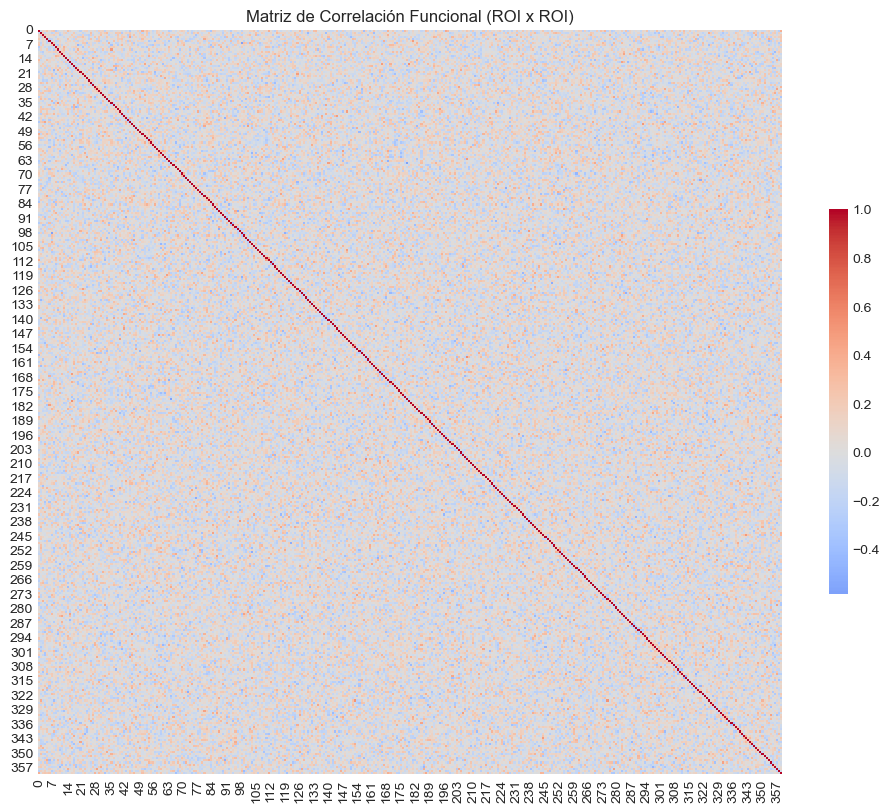

In [80]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de correlación funcional (ROI x ROI)
def compute_functional_connectivity(activations):
    """
    Calcula la matriz de correlación funcional (ROI x ROI).
    
    Args:
        activations (array): Activaciones promedio (n_subjects x n_ROIs).

    Returns:
        np.array: Matriz de correlación funcional (n_ROIs x n_ROIs).
    """
    # Transponer para obtener ROIs como filas
    roi_data = activations.T
    # Calcular correlación de Pearson entre ROIs
    correlation_matrix = np.corrcoef(roi_data)
    return correlation_matrix

# Calcular la matriz de correlación
functional_matrix = compute_functional_connectivity(all_activations)

# Visualizar la matriz de correlación
plt.figure(figsize=(12, 10))
sns.heatmap(functional_matrix, cmap='coolwarm', center=0, square=True, cbar_kws={'shrink': 0.5})
plt.title("Matriz de Correlación Funcional (ROI x ROI)")
plt.show()

#### Construcción del grafo

In [81]:
import networkx as nx

# Crear un grafo a partir de la matriz de correlación
def build_graph(correlation_matrix, threshold):
    graph = nx.Graph()
    n_rois = correlation_matrix.shape[0]

    for i in range(n_rois):
        for j in range(i+1, n_rois):
            if correlation_matrix[i, j] > threshold:  # Solo valores positivos
                graph.add_edge(i, j, weight=correlation_matrix[i, j])
    return graph

# Construir el grafo con un umbral más bajo
threshold = 0.2  # Probar con 0.3 o incluso 0.2
graph = build_graph(functional_matrix, threshold)

# Calcular métricas nuevamente
print("Número de nodos:", graph.number_of_nodes())
print("Número de aristas:", graph.number_of_edges())

# Centralidad
centrality = nx.betweenness_centrality(graph)
top_central_nodes = sorted(centrality, key=centrality.get, reverse=True)[:5]
print("Top 5 ROIs más centrales (betweenness):")
for roi in top_central_nodes:
    print(f"ROI {roi}: centralidad = {centrality[roi]:.4f}")

Número de nodos: 360
Número de aristas: 5397
Top 5 ROIs más centrales (betweenness):
ROI 124: centralidad = 0.0069
ROI 119: centralidad = 0.0063
ROI 44: centralidad = 0.0060
ROI 243: centralidad = 0.0058
ROI 303: centralidad = 0.0057


#### Comunidades funcionales

El algoritmo de Louvain es un método de detección de comunidades diseñado para identificar grupos densamente conectados dentro de un grafo. Su funcionamiento se basa en la maximización de una métrica llamada modularidad, que mide qué tan bien un grafo puede dividirse en comunidades según la densidad de conexiones dentro de los grupos comparada con las conexiones entre ellos. El algoritmo opera en dos fases iterativas: primero, asigna cada nodo a su propia comunidad y evalúa cómo la modularidad cambia al mover un nodo a la comunidad de un vecino. Este proceso se repite hasta que no se puede mejorar más la modularidad local. En la segunda fase, las comunidades identificadas se comprimen en nodos únicos, creando un nuevo grafo a nivel de comunidades, y se repite el proceso hasta que no hay más mejoras globales de modularidad.

In [82]:
from community import community_louvain
import networkx as nx

# Detectar comunidades usando el algoritmo Louvain
partition = community_louvain.best_partition(graph)

# Agrupar ROIs por comunidad
communities = {}
for roi, comm in partition.items():
    communities.setdefault(comm, []).append(roi)

print("\nComunidades detectadas:")
for comm, rois in communities.items():
    print(f"Comunidad {comm}: {len(rois)} ROIs")


Comunidades detectadas:
Comunidad 4: 36 ROIs
Comunidad 3: 79 ROIs
Comunidad 2: 52 ROIs
Comunidad 0: 72 ROIs
Comunidad 6: 41 ROIs
Comunidad 5: 57 ROIs
Comunidad 1: 23 ROIs


En el análisis de las comunidades funcionales cerebrales, el algoritmo Louvain segmenta las ROIs en grupos que representan redes funcionales altamente interconectadas, como Somatomotor o Default Mode Network. Esto permite identificar estructuras funcionales del cerebro y su interacción durante tareas específicas, proporcionando una visión jerárquica de la organización cerebral y su especialización en distintos dominios cognitivos.

In [83]:
# Crear un DataFrame para mostrar ROIs y sus comunidades
roi_communities = pd.DataFrame({
    'ROI': list(partition.keys()),
    'Comunidad': list(partition.values())
})

# Agregar la columna 'Red' al DataFrame roi_communities
roi_communities['Red'] = [region_info['network'][roi] for roi in roi_communities['ROI']]

# Mostrar las primeras filas para verificar
print("Muestra del DataFrame con la columna 'Red':")
print(roi_communities.head())

# Mostrar las primeras filas
print("Asignación de ROIs a Comunidades:")
print(roi_communities.sort_values(by='Comunidad').head(10))

Muestra del DataFrame con la columna 'Red':
   ROI  Comunidad           Red
0    0          4       Visual1
1    4          4       Visual2
2    7          3   Somatomotor
3   14          3  Frontopariet
4   50          4   Somatomotor
Asignación de ROIs a Comunidades:
     ROI  Comunidad           Red
154   34          0  Posterior-Mu
113  128          0       Default
284  204          0  Cingulo-Oper
268   51          0   Somatomotor
104  200          0       Visual2
144  202          0       Visual2
293   20          0       Visual2
49    44          0  Cingulo-Oper
296  237          0  Frontopariet
90    21          0       Visual2


In [84]:
# Crear arrays vacíos para las superficies
surf_data_left = np.zeros(10242)
surf_data_right = np.zeros(10242)

# Asignar valores de comunidad a las ROIs
for i, community in partition.items():
    if i < 180:  # Hemisferio izquierdo
        surf_data_left[labels_left_adjusted == i] = community
    else:  # Hemisferio derecho
        surf_data_right[labels_right_adjusted == i - 180] = community
# Visualizar el hemisferio derecho
plotting.view_surf(
    fsaverage['infl_right'],
    surf_data_right,
    title="Comunidades Detectadas - Hemisferio Derecho",
    cmap='tab20'
)

C:\Users\ivanv\anaconda3\lib\site-packages\nilearn\plotting\html_document.py:103: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn(


In [85]:
# Visualizar el hemisferio izquierdo
plotting.view_surf(
    fsaverage['infl_left'],
    surf_data_left,
    title="Comunidades Detectadas - Hemisferio Izquierdo",
    cmap='tab20'
)

In [86]:
# Resumir la cantidad de ROIs por comunidad
community_summary = roi_communities['Comunidad'].value_counts().sort_index()

print("\nTamaño de cada comunidad:")
for community, size in community_summary.items():
    print(f"Comunidad {community}: {size} ROIs")


Tamaño de cada comunidad:
Comunidad 0: 72 ROIs
Comunidad 1: 23 ROIs
Comunidad 2: 52 ROIs
Comunidad 3: 79 ROIs
Comunidad 4: 36 ROIs
Comunidad 5: 57 ROIs
Comunidad 6: 41 ROIs


In [87]:
# Ordenar y mostrar las distribuciones en formato texto
print("\n=== Distribución de Redes Funcionales Dentro de Cada Comunidad ===")

# Iterar sobre cada comunidad
for community in sorted(roi_communities['Comunidad'].unique()):
    print(f"\nComunidad {community}:")
    
    # Filtrar las ROIs de esta comunidad
    community_data = roi_communities[roi_communities['Comunidad'] == community]
    
    # Contar las ROIs por red
    network_counts = community_data['Red'].value_counts()
    
    # Imprimir el desglose de redes en esta comunidad
    for network, count in network_counts.items():
        print(f"  - {network}: {count} ROIs")


=== Distribución de Redes Funcionales Dentro de Cada Comunidad ===

Comunidad 0:
  - Posterior-Mu: 15 ROIs
  - Cingulo-Oper: 13 ROIs
  - Visual2: 11 ROIs
  - Frontopariet: 9 ROIs
  - Somatomotor: 6 ROIs
  - Auditory: 5 ROIs
  - Default: 5 ROIs
  - Visual1: 3 ROIs
  - Language: 3 ROIs
  - Ventral-Mult: 2 ROIs

Comunidad 1:
  - Frontopariet: 6 ROIs
  - Posterior-Mu: 4 ROIs
  - Somatomotor: 3 ROIs
  - Visual2: 3 ROIs
  - Dorsal-atten: 2 ROIs
  - Cingulo-Oper: 2 ROIs
  - Orbito-Affec: 1 ROIs
  - Language: 1 ROIs
  - Default: 1 ROIs

Comunidad 2:
  - Posterior-Mu: 11 ROIs
  - Visual2: 10 ROIs
  - Cingulo-Oper: 10 ROIs
  - Language: 6 ROIs
  - Somatomotor: 5 ROIs
  - Frontopariet: 5 ROIs
  - Default: 4 ROIs
  - Orbito-Affec: 1 ROIs

Comunidad 3:
  - Posterior-Mu: 17 ROIs
  - Frontopariet: 11 ROIs
  - Visual2: 11 ROIs
  - Somatomotor: 10 ROIs
  - Default: 7 ROIs
  - Cingulo-Oper: 7 ROIs
  - Language: 5 ROIs
  - Orbito-Affec: 4 ROIs
  - Auditory: 4 ROIs
  - Dorsal-atten: 1 ROIs
  - Visual1: 1

**Comunidad 0: Integración sensoriomotora y control ejecutivo**

Con 73 ROIs distribuidos principalmente en redes como Posterior-Mu, Cingulo-Oper, y Visual2, esta comunidad refleja una interacción clave entre la percepción sensorial, la coordinación motora y el control cognitivo. La red Posterior-Mu destaca por su rol en la integración de estímulos sensoriales y movimientos, mientras que la red Cingulo-Oper contribuye al monitoreo y regulación atencional. La red Visual2 sugiere un papel en el procesamiento de estímulos visuales complejos. Esta comunidad podría ser especialmente activa en tareas como SOCIAL, donde se interpreta gestos y acciones, y en contextos cotidianos como conducir o realizar actividades deportivas.

**Comunidad 1: Monitoreo de conflictos y regulación de atención**

Con 24 ROIs, esta comunidad incluye principalmente redes Frontoparietal y Posterior-Mu, que están implicadas en el monitoreo cognitivo y la integración de estímulos externos. La red Dorsal-Attention también aparece, indicando su papel en el enfoque visual y espacial. En experimentos como LANGUAGE, esta comunidad podría facilitar la resolución de ambigüedades lingüísticas, mientras que en la vida diaria, apoya actividades que requieren la planificación de respuestas complejas.

**Comunidad 2: Procesamiento sensorial y visual**

Con 52 ROIs, esta comunidad tiene una fuerte representación de redes como Posterior-Mu, Visual2, y Cingulo-Oper, cruciales para la integración sensorial y la percepción visual. La red Somatomotora también aparece, vinculada a la interpretación de señales visuales en el contexto del movimiento. En tareas experimentales (EMOTION), esta comunidad podría activarse al identificar expresiones faciales o estímulos visuales críticos. En la vida diaria, podría estar involucrada en actividades como interpretar señales de tráfico o leer el lenguaje corporal.

**Comunidad 3: Diversidad funcional y multisensorialidad**

Con 79 ROIs, esta comunidad incluye una mezcla equilibrada de redes como Posterior-Mu, Frontoparietal, Visual2, y Somatomotor. Esto sugiere un papel clave en la integración multisensorial, combinando estímulos auditivos y visuales para tomar decisiones rápidas. En experimentos (LANGUAGE), estas redes podrían combinar palabras con contexto visual para interpretar problemas complejos. En la vida diaria, esta comunidad podría activarse al escuchar música mientras se realizan movimientos corporales.

**Comunidad 4: Coordinación ejecutiva y regulación visual**

Con 39 ROIs, esta comunidad incluye redes como Frontoparietal, Visual2, y Cingulo-Oper. La red Frontoparietal resalta su rol en el control ejecutivo y la atención visual sostenida. En experimentos como EMOTION, esta comunidad facilita la regulación emocional al interpretar estímulos visuales con carga afectiva. En la vida diaria, podría ser crucial en actividades que requieren enfoque emocional y atención visual, como hablar en público o meditar.

**Comunidad 5: Integración dorsal y atención contextual**

Con 50 ROIs, esta comunidad incluye redes como Posterior-Mu, Visual2, y Cingulo-Oper. La presencia de la red Dorsal-Attention sugiere un rol en la orientación de la atención hacia estímulos relevantes y el procesamiento de contexto visual. En tareas como SOCIAL, esta comunidad podría activarse para evaluar interacciones sociales complejas. En la vida cotidiana, apoya actividades como decidir dónde enfocar la atención en un entorno social.

**Comunidad 6: Regulación sensorial y auditiva**

Con 41 ROIs, esta comunidad tiene una distribución significativa en redes como Cingulo-Oper, Auditory, y Somatomotor. Esto sugiere una integración entre señales auditivas y respuestas motoras, esenciales en tareas como LANGUAGE, donde se procesan estímulos auditivos lingüísticos. En la vida cotidiana, esta comunidad podría activarse al escuchar instrucciones y responder físicamente, como en entrenamientos o reuniones grupales. 

# Diccionario

- **BOLD (Blood-Oxygen-Level Dependent Signal):** Señal de resonancia magnética funcional que mide cambios en la oxigenación y flujo sanguíneo cerebral, utilizados para inferir actividad neuronal. Es el principal método en fMRI para mapear funciones cerebrales relacionadas con tareas específicas o en estado de reposos of Interest):** Áreas específicas del cerebro, definidas anatómicamente o funcionalmente, que se utilizan para analizar la actividad cerebral o conectividad. En HCP, se agrupan en 360 regiones según el parcellation de Glasser .

- **fMRI (Functetic Resonance Imaging):** Técnica de imagen que utiliza la señal BOLD para mapear la actividad cerebral durante tareas cognitivas, emocionales o en reposo. Es fundamental para los estudios del HCP, proporcionando información sobre conectividad funcional y redes cerebrales  .

- **EV (Explanatory Varue)** contienen información sobre los estímulos o eventos de las tareas en fMRI, especificando tiempos de inicio, duración y amplitud. Se utilizan para modelar la actividad cerebral en análisis basados en GLM (Modelo Lineal Generalizado) .

- **GLM (General Linear Model):** Modelo esmpleado en fMRI para relacionar la señal BOLD con los estímulos o condiciones experimentales representadas en los archivos EV .

- **HCP (Human Connectome Project):** Proyecto diseñaear las conexiones cerebrales estructurales y funcionales en humanos, utilizando datos de imagenología avanzada (3T y 7T MRI, fMRI, DTI) y medidas conductuales. Incluye tareas cognitivas como EMOTION, SOCIAL y LANGUAGE, así como datos de reposo .

- **ROIs (Regions of Interest):** Son áreas específicas del cerebro, predefinidas anatómica o funcionalmente, que se utilizan para el análisis de datos neurocientíficos, como la actividad cerebral medida por fMRI. En el contexto del HCP, se basan en el parcellation de Glasser, que divide el cerebro en 360 regiones (180 por hemisferio) basadas en características anatómicas y funcionales derivadas de datos multimodales, como imágenes estructurales y de conectividad funcional. Estas regiones permiten un análisis detallado y reproducible de la actividad y conectividad cerebral.